# PayPal Topic Modeling Notebook
---

## Download and install requisite libraries and packages
---

In [1]:
import sys

!pip install -r data/requirements.txt

     |████████████████████████████████| 46.9 MB 13.4 MB/s eta 0:00:01
     |████████████████████████████████| 12.9 MB 52.5 MB/s eta 0:00:01
     |████████████████████████████████| 366 kB 58.1 MB/s eta 0:00:01
     |████████████████████████████████| 80 kB 11.9 MB/s eta 0:00:01
     |████████████████████████████████| 275 kB 70.9 MB/s eta 0:00:01
     |████████████████████████████████| 271 kB 70.3 MB/s eta 0:00:01
     |████████████████████████████████| 622 kB 50.9 MB/s eta 0:00:01
     |████████████████████████████████| 621 kB 47.9 MB/s eta 0:00:01
     |████████████████████████████████| 42 kB 2.2 MB/s  eta 0:00:01
     |████████████████████████████████| 9.8 MB 43.4 MB/s eta 0:00:01
     |████████████████████████████████| 9.2 MB 49.3 MB/s eta 0:00:01
     |████████████████████████████████| 126 kB 75.2 MB/s eta 0:00:01
     |████████████████████████████████| 75 kB 6.6 MB/s  eta 0:00:01
     |████████████████████████████████| 456 kB 74.3 MB/s eta 0:00:01
     |█████████████████████████████

### JupyterLab renderer support
install the required JupyterLab extensions

In [2]:
!conda install -c conda-forge nodejs -y
!conda install -c plotly plotly-orca -y

Solving environment: / 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - conda-forge/noarch::seaborn-base==0.11.1=pyhd8ed1ab_1
  - conda-forge/noarch::nbclassic==0.2.6=pyhd8ed1ab_0
  - conda-forge/linux-64::blaze==0.11.3=py36_0
  - conda-forge/linux-64::matplotlib==3.3.4=py36h5fab9bb_0
  - defaults/linux-64::_anaconda_depends==5.1.0=py36_2
  - conda-forge/noarch::jupyterlab==3.0.9=pyhd8ed1ab_0
  - conda-forge/noarch::python-language-server==0.36.2=pyhd8ed1ab_0
  - conda-forge/noarch::jupyterlab_server==2.3.0=pyhd8ed1ab_0
  - conda-forge/noarch::pyls-black==0.4.6=pyh9f0ad1d_0
  - conda-forge/linux-64::scikit-image==0.16.2=py36hb3f55d8_0
  - conda-forge/noarch::black==20.8b1=py_1
  - conda-forge/linux-64::anyio==2.1.0=py36h5fab9bb_0
  - conda-forge/linux-64::jupyter_server==1.4.1=py36h5fab9bb_0
  - conda-forge/linux-64::bokeh==2.2.3=py36h5fab9bb_0
  - conda-forge/noarch::numpydoc==1.1.0=py_1
  - conda-forg

In [3]:
!jupyter labextension install jupyterlab-plotly

Config option `kernel_spec_manager_class` not recognized by `InstallLabExtensionApp`.
[W 2021-07-02 01:28:55.438 LabApp] Config option `kernel_spec_manager_class` not recognized by `LabApp`.
Building jupyterlab assets (production, minimized)


In [1]:
import matplotlib.pyplot as plt
import plotly.express as px
import wordcloud as wc
import seaborn as sns
import pandas as pd 
import numpy as np
import mxnet as mx
import tarfile
import zipfile
import sklearn
import os
from datetime_truncate import truncate

## Import and prepare CSV files
---

### Import CSV files

In [42]:
complete_df = pd.read_csv('data/PayPal/complete_paypal_play_store_reviews.csv')

# convert date columns to datetime since dtypes aren't preserved in csv files
complete_df['date'] = pd.to_datetime(complete_df['at'])

# get review data from January 1, 2020 (12 AM) until June 3, 2021 (12 AM)
mask = (complete_df['date'] > '2020-01-01 00:00:00') & (complete_df['date'] < '2021-06-04 00:00:00')
complete_df = complete_df.loc[mask]

# create and append month column
complete_df['month'] = complete_df['date'].apply(lambda x: truncate(x, 'month').date())
complete_df['month'] = pd.to_datetime(complete_df['month'])

complete_df['type'] = 'play store'
complete_df['rating'] = complete_df['score']
complete_df['review'] = complete_df['content']
complete_df = complete_df.drop(['reviewId', 'userName', 'userImage', 'thumbsUpCount', 'replyContent', 'repliedAt', 'content', 'score', 'at', 'reviewCreatedVersion'], axis=1)

data1 = pd.read_csv('data/PayPal/paypal_combined_reviews.csv')

complete_df = complete_df.append(data1, ignore_index=True)
complete_df
# drop rows that have NULL entries
complete_df = complete_df.dropna()

# drop rows that have duplicates
complete_df = complete_df.drop_duplicates()

# sort by date
complete_df['date'] = pd.to_datetime(complete_df['date'])
complete_df['month'] = pd.to_datetime(complete_df['month'])
complete_df = complete_df.sort_values(by=['date'])

# cast float64 rating column to int32
complete_df['rating'] = complete_df['rating'].astype('int32')

complete_df.info()
print(display(complete_df))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 294309 entries, 162600 to 273000
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    294309 non-null  datetime64[ns]
 1   month   294309 non-null  datetime64[ns]
 2   type    294309 non-null  object        
 3   rating  294309 non-null  int32         
 4   review  294309 non-null  object        
dtypes: datetime64[ns](2), int32(1), object(2)
memory usage: 12.3+ MB


,date,month,type,rating,review
162600,2020-01-01 00:13:54,2020-01-01,play store,5,Best app ever!
273535,2020-01-01 00:13:54,2020-01-01,play store,5,Best app ever!
284390,2020-01-01 00:35:51,2020-01-01,play store,5,Works good
162599,2020-01-01 00:35:51,2020-01-01,play store,5,Works good
162598,2020-01-01 00:43:13,2020-01-01,play store,5,Great app.
...,...,...,...,...,...
253718,2021-06-25 09:25:53,2021-06-01,play store,5,Thank you paypal
264392,2021-06-25 09:54:22,2021-06-01,play store,5,Yehey my on hold money was transferred to my a...
281820,2021-06-25 09:59:20,2021-06-01,play store,5,Fastest way to send money and safest
165974,2021-06-25 10:15:03,2021-06-01,play store,1,Worst app. They can't solve any issue and all ...


None


In [43]:
complete_df['rating'].unique()

array([5, 1, 2, 4, 3])

In [44]:
mask = ((complete_df['rating'] == 1) | (complete_df['rating'] == 5))
combined_df = complete_df.loc[mask]

combined_df.info()
print(display(combined_df))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 269039 entries, 162600 to 273000
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    269039 non-null  datetime64[ns]
 1   month   269039 non-null  datetime64[ns]
 2   type    269039 non-null  object        
 3   rating  269039 non-null  int32         
 4   review  269039 non-null  object        
dtypes: datetime64[ns](2), int32(1), object(2)
memory usage: 11.3+ MB


,date,month,type,rating,review
162600,2020-01-01 00:13:54,2020-01-01,play store,5,Best app ever!
273535,2020-01-01 00:13:54,2020-01-01,play store,5,Best app ever!
284390,2020-01-01 00:35:51,2020-01-01,play store,5,Works good
162599,2020-01-01 00:35:51,2020-01-01,play store,5,Works good
162598,2020-01-01 00:43:13,2020-01-01,play store,5,Great app.
...,...,...,...,...,...
253718,2021-06-25 09:25:53,2021-06-01,play store,5,Thank you paypal
264392,2021-06-25 09:54:22,2021-06-01,play store,5,Yehey my on hold money was transferred to my a...
281820,2021-06-25 09:59:20,2021-06-01,play store,5,Fastest way to send money and safest
165974,2021-06-25 10:15:03,2021-06-01,play store,1,Worst app. They can't solve any issue and all ...


None


In [45]:
combined_df['rating'].unique()

array([5, 1])

## Exploratory Data Analysis
---

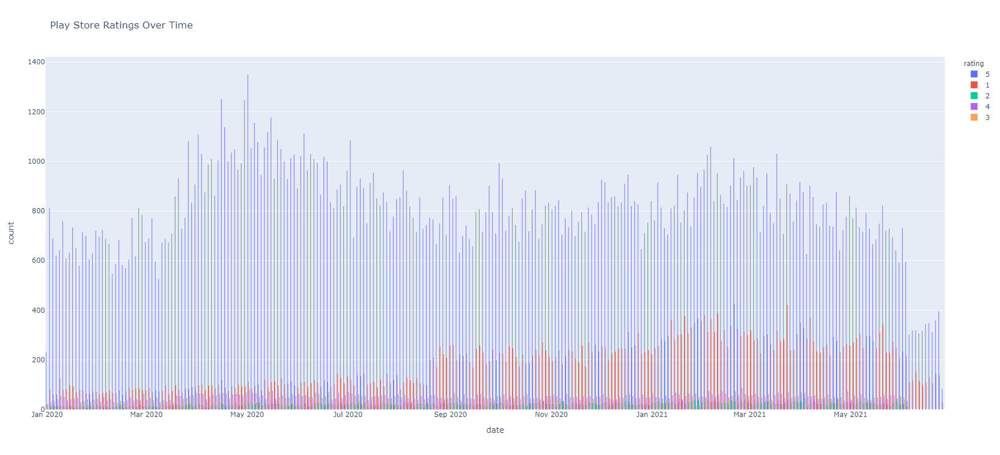

In [46]:
fig = px.histogram(
    complete_df.loc[(complete_df['type'] == 'play store')], 
    x='date',
    color='rating',
    title='Play Store Ratings Over Time',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

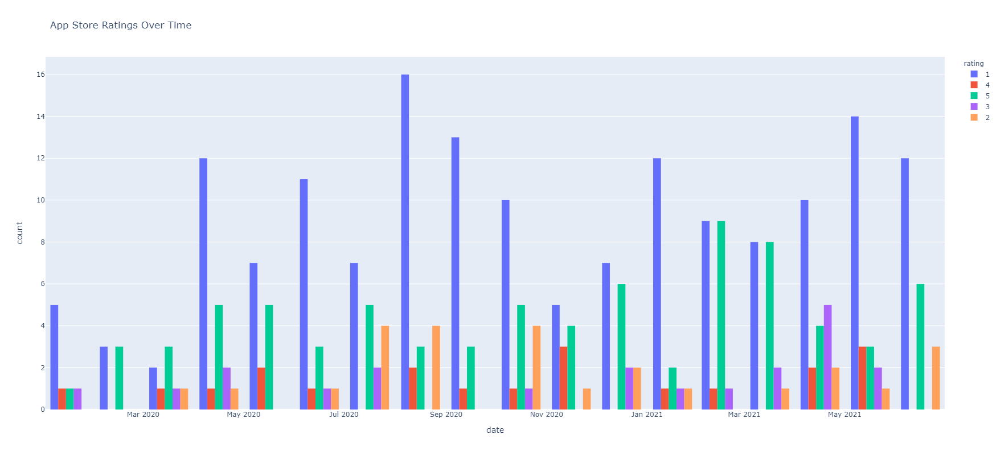

In [51]:
fig = px.histogram(
    complete_df.loc[(complete_df['type'] == 'app store')], 
    x='date',
    color='rating',
    title='App Store Ratings Over Time',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

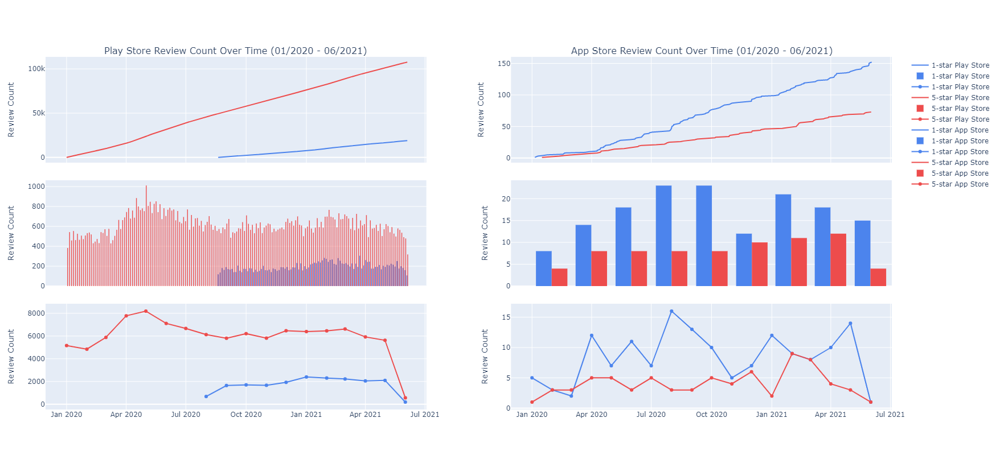

In [6]:
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# set default renderer
# for local
pio.renderers.default = "jupyterlab"

# for sagemaker
# pio.renderers.default = "iframe"

# disable false positive warning
pd.options.mode.chained_assignment = None  # default='warn'

ax_1 = combined_df.loc[(combined_df['type'] == 'play store') & (combined_df['rating'] == 1)]
ax_5 = combined_df.loc[(combined_df['type'] == 'play store') & (combined_df['rating'] == 5)]
ax_1 = ax_1.sort_values(by=['date'])
ax_5 = ax_5.sort_values(by=['date'])
ax_1['cumsum'] = ax_1['rating'].eq(1).cumsum()
ax_5['cumsum'] = ax_5['rating'].eq(5).cumsum()
ax_1_ratings = ax_1.groupby(['month', 'rating'])['review'].count().reset_index()
ax_5_ratings = ax_5.groupby(['month', 'rating'])['review'].count().reset_index()

bx_1 = combined_df.loc[(combined_df['type'] == 'app store') & (combined_df['rating'] == 1)]
bx_5 = combined_df.loc[(combined_df['type'] == 'app store') & (combined_df['rating'] == 5)]
bx_1 = bx_1.sort_values(by=['date'])
bx_5 = bx_5.sort_values(by=['date'])
bx_1['cumsum'] = bx_1['rating'].eq(1).cumsum()
bx_5['cumsum'] = bx_5['rating'].eq(5).cumsum()
bx_1_ratings = bx_1.groupby(['month', 'rating'])['review'].count().reset_index()
bx_5_ratings = bx_5.groupby(['month', 'rating'])['review'].count().reset_index()

fig = make_subplots(
    rows=3, 
    cols=2, 
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=("Play Store Review Count Over Time (01/2020 - 06/2021)", "App Store Review Count Over Time (01/2020 - 06/2021)")
)

# Play Store
fig.add_trace(
    go.Scatter(
        x=ax_1['date'],
        y=ax_1['cumsum'],
        name='1-star Play Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=1
)
fig.add_trace(
    go.Histogram(
        x=ax_1['date'],
        y=ax_1['rating'],
        name='1-star Play Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=1
)
fig.add_trace(
    go.Scatter(
        x=ax_1_ratings['month'],
        y=ax_1_ratings['review'],
        name='1-star Play Store',
        marker=dict(color='#4c84ed')
    ),
    row=3, 
    col=1
)
fig.add_trace(
    go.Scatter(
        x=ax_5['date'],
        y=ax_5['cumsum'],
        name='5-star Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=1
)
fig.add_trace(
    go.Histogram(
        x=ax_5['date'],
        y=ax_5['rating'],
        name='5-star Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=1
)
fig.add_trace(
    go.Scatter(
        x=ax_5_ratings['month'],
        y=ax_5_ratings['review'],
        name='5-star Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=3, 
    col=1
)

# App Store
fig.add_trace(
    go.Scatter(
        x=bx_1['date'],
        y=bx_1['cumsum'],
        name='1-star App Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=2
)
fig.add_trace(
    go.Histogram(
        x=bx_1['date'],
        y=bx_1['rating'],
        name='1-star App Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=2
)
fig.add_trace(
    go.Scatter(
        x=bx_1_ratings['month'],
        y=bx_1_ratings['review'],
        name='1-star App Store',
        marker=dict(color='#4c84ed')
    ),
    row=3, 
    col=2
)
fig.add_trace(
    go.Scatter(
        x=bx_5['date'],
        y=bx_5['cumsum'],
        name='5-star App Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=2
)
fig.add_trace(
    go.Histogram(
        x=bx_5['date'],
        y=bx_5['rating'],
        name='5-star App Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=2
)
fig.add_trace(
    go.Scatter(
        x=bx_5_ratings['month'],
        y=bx_5_ratings['review'],
        name='5-star App Store',
        marker=dict(color='#ed4c4c')
    ),
    row=3, 
    col=2
)

# Update yaxis properties
fig.update_yaxes(title_text="Review Count")
fig.update_layout(width=1450, height=800)
fig.show()

### Hour of the day
---

In [7]:
# Collect and store all App Store reviews in a temporary DF
ax = complete_df.loc[(complete_df['type'] == 'play store')]
ax = ax.sort_values(by=['date'])

# df = df.groupby([df['Date'].dt.hour, 'weekday'])['Cyclists'].sum().unstack().plot()

gps_avg_rating_hr = ax.groupby(ax['date'].dt.hour)['rating'].mean().reset_index().rename(
    columns = {'date' : 'hour'}
)
gps_avg_rating_hr.head()

,hour,rating
0,0,4.477071
1,1,4.446759
2,2,4.402049
3,3,4.351425
4,4,4.277764


In [8]:
# Collect and store all App Store reviews in a temporary DF
bx = complete_df.loc[(complete_df['type'] == 'app store')]
bx = bx.sort_values(by=['date'])

# df = df.groupby([df['Date'].dt.hour, 'weekday'])['Cyclists'].sum().unstack().plot()

as_avg_rating_hr = bx.groupby(bx['date'].dt.hour)['rating'].mean().reset_index().rename(
    columns = {'date' : 'hour'}
)
as_avg_rating_hr.head()

,hour,rating
0,0,2.571429
1,1,3.090909
2,2,2.687500
3,3,1.937500
4,4,2.941176


### Day of the week
---

In [9]:
days = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

gps_avg_rating_day = ax.groupby(ax['date'].dt.day_name())['rating'].mean().reindex(days).reset_index().rename(
    columns = {'date' : 'day'}
)
gps_avg_rating_day

,day,rating
0,Monday,4.397568
1,Tuesday,4.366343
2,Wednesday,4.395275
3,Thursday,4.400827
4,Friday,4.446500
5,Saturday,4.405439
6,Sunday,4.403847


In [10]:
as_avg_rating_day = bx.groupby(bx['date'].dt.day_name())['rating'].mean().reindex(days).reset_index().rename(
    columns = {'date' : 'day'}
)
as_avg_rating_day

,day,rating
0,Monday,2.419355
1,Tuesday,2.451613
2,Wednesday,2.725000
3,Thursday,2.447368
4,Friday,2.194444
5,Saturday,2.208333
6,Sunday,2.685714


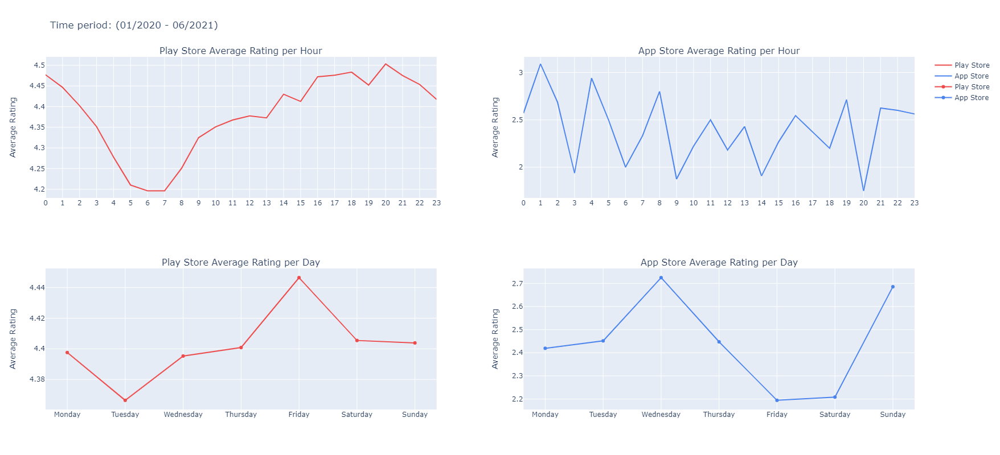

In [11]:
fig = make_subplots(
    rows=2, 
    cols=2, 
#     shared_xaxes=True,
#     shared_yaxes=True,
    vertical_spacing=0.2,
    subplot_titles=("Play Store Average Rating per Hour", "App Store Average Rating per Hour", \
                   "Play Store Average Rating per Day", "App Store Average Rating per Day")
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_hr['hour'],
        y=gps_avg_rating_hr['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_hr['hour'],
        y=as_avg_rating_hr['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=2
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_day['day'],
        y=gps_avg_rating_day['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_day['day'],
        y=as_avg_rating_day['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=2
)

fig.update_layout(title_text="Time period: (01/2020 - 06/2021)", width=1450, height=800)
# Update yaxis and xaxis properties
fig.update_yaxes(title_text="Average Rating")
fig.update_xaxes(dtick=1)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1700, height=800)

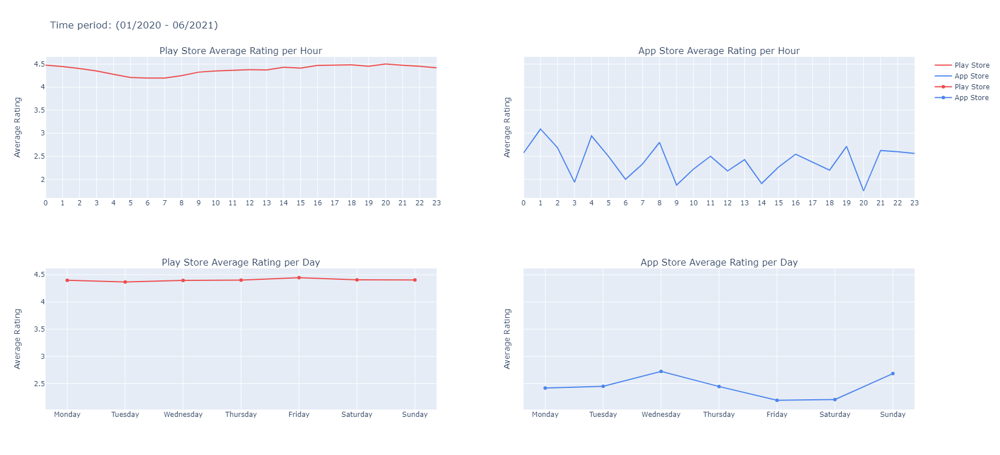

In [12]:
fig = make_subplots(
    rows=2, 
    cols=2, 
#     shared_xaxes=True,
    shared_yaxes=True,
    vertical_spacing=0.2,
    subplot_titles=("Play Store Average Rating per Hour", "App Store Average Rating per Hour", \
                   "Play Store Average Rating per Day", "App Store Average Rating per Day")
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_hr['hour'],
        y=gps_avg_rating_hr['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_hr['hour'],
        y=as_avg_rating_hr['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=2
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_day['day'],
        y=gps_avg_rating_day['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_day['day'],
        y=as_avg_rating_day['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=2
)

fig.update_layout(title_text="Time period: (01/2020 - 06/2021)", width=1450, height=800)
# Update yaxis and xaxis properties
fig.update_yaxes(title_text="Average Rating")
fig.update_xaxes(dtick=1)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1700, height=800)


Mean word count: 9.963754734848484
1-star mean word count: 28.007879392761463
5-star mean word count: 6.773780448167306


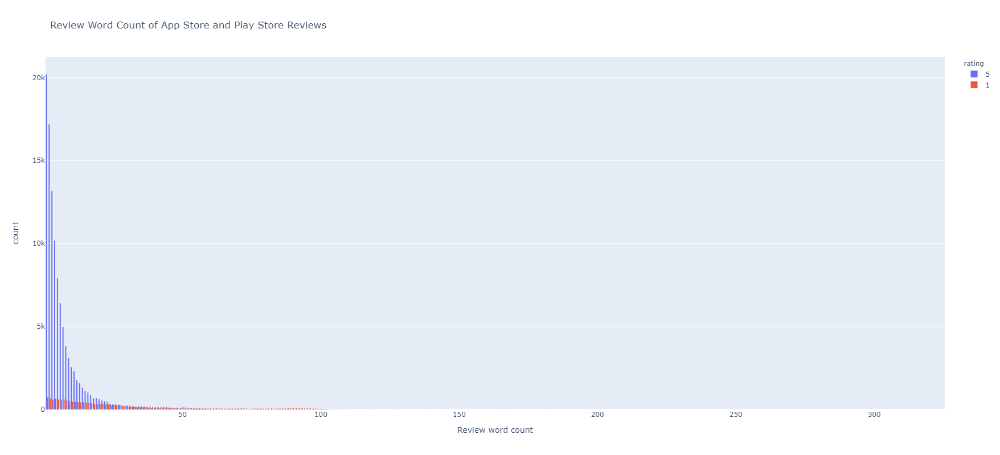

In [13]:
# init empty DF
cx = pd.DataFrame()

# Collect and store all App Store reviews in a temporary DF
cx = combined_df

mask = (complete_df['rating'] == 1)
cx_1 = complete_df.loc[mask]

mask = (complete_df['rating'] == 5)
cx_5 = complete_df.loc[mask]

cx['Review word count'] = cx['review'].str.split().str.len()
cx_1['Review word count'] = cx_1['review'].str.split().str.len()
cx_5['Review word count'] = cx_5['review'].str.split().str.len()
print(f"\nMean word count: {cx['Review word count'].mean()}")
print(f"1-star mean word count: {cx_1['Review word count'].mean()}")
print(f"5-star mean word count: {cx_5['Review word count'].mean()}")

fig = px.histogram(
    cx, 
    x='Review word count',
    color='rating',
    labels=['Word count', 'Review count'],
    title='Review Word Count of App Store and Play Store Reviews',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1000, height=500)

### Play Store

Total number of Play Store reviews: 126495
Total number of 1-star Play Store reviews: 18885
Total number of 5-star Play Store reviews: 107610

Play Store reviews mean word count: 9.923902130518993
1-star reviews mean word count: 27.91517077045274
5-star reviews mean word count: 6.766527274416876


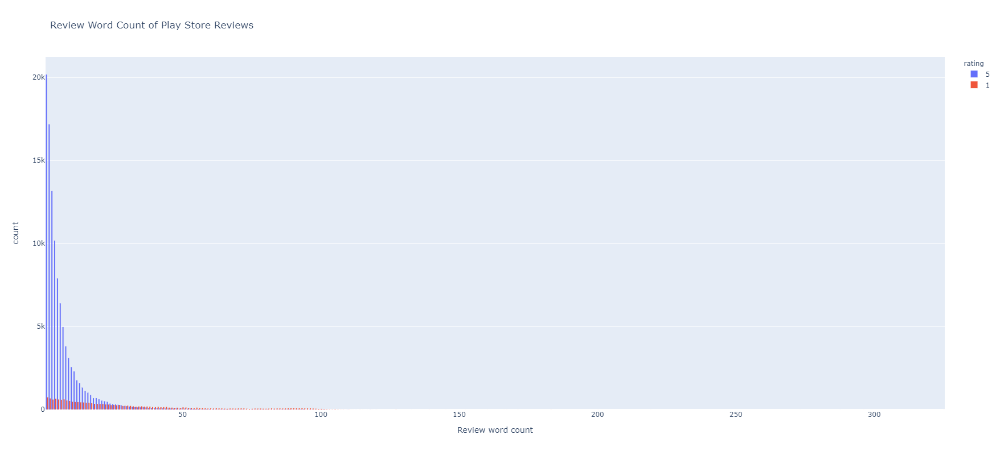

In [14]:
ax = combined_df.loc[(combined_df['type'] == 'play store')]
ax_ct = ax['review'].count()
ax_1_ct = ax_1['review'].count()
ax_5_ct = ax_5['review'].count()

print(f'Total number of Play Store reviews: {ax_ct}')
print(f'Total number of 1-star Play Store reviews: {ax_1_ct}')
print(f'Total number of 5-star Play Store reviews: {ax_5_ct}')

ax['Review word count'] = ax['review'].str.split().str.len()
ax_1['Review word count'] = ax_1['review'].str.split().str.len()
ax_5['Review word count'] = ax_5['review'].str.split().str.len()
print(f"\nPlay Store reviews mean word count: {ax['Review word count'].mean()}")
print(f"1-star reviews mean word count: {ax_1['Review word count'].mean()}")
print(f"5-star reviews mean word count: {ax_5['Review word count'].mean()}")

fig = px.histogram(
    ax, 
    x='Review word count',
    color='rating',
    labels=['Word count', 'Review count'],
    title='Review Word Count of Play Store Reviews',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1000, height=500)

### App Store

Total number of App Store reviews: 225
Total number of 1-star App Store reviews: 152
Total number of 5-star App Store reviews: 73

App Store reviews mean word count: 32.36888888888889
1-star reviews mean word count: 39.526315789473685
5-star reviews mean word count: 17.465753424657535


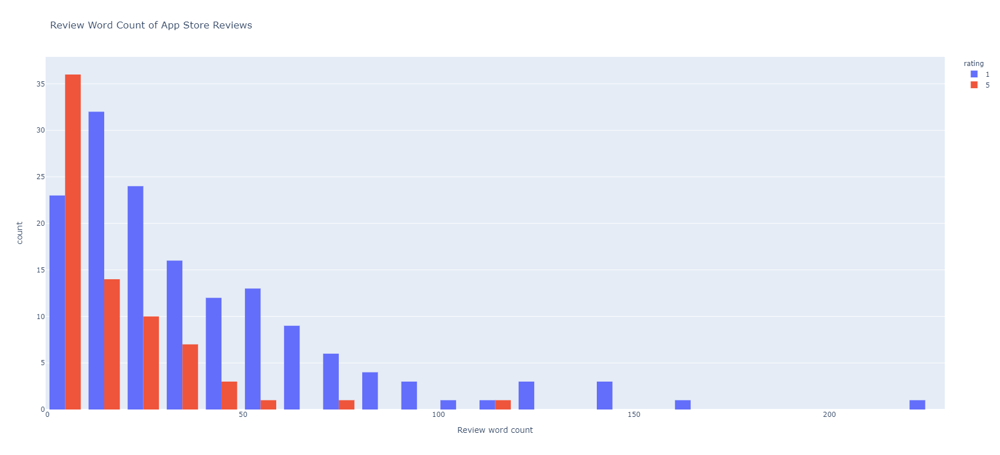

In [15]:
bx = combined_df.loc[(combined_df['type'] == 'app store')]
bx_ct = bx['review'].count()
bx_1_ct = bx_1['review'].count()
bx_5_ct = bx_5['review'].count()

print(f'Total number of App Store reviews: {bx_ct}')
print(f'Total number of 1-star App Store reviews: {bx_1_ct}')
print(f'Total number of 5-star App Store reviews: {bx_5_ct}')

bx['Review word count'] = bx['review'].str.split().str.len()
bx_1['Review word count'] = bx_1['review'].str.split().str.len()
bx_5['Review word count'] = bx_5['review'].str.split().str.len()
print(f"\nApp Store reviews mean word count: {bx['Review word count'].mean()}")
print(f"1-star reviews mean word count: {bx_1['Review word count'].mean()}")
print(f"5-star reviews mean word count: {bx_5['Review word count'].mean()}")

fig = px.histogram(
    bx, 
    x='Review word count',
    color='rating',
    labels=['Word count', 'Review count'],
    title='Review Word Count of App Store Reviews',
    barmode='group',
    width=1000, 
    height=500
)

fig.update_layout(width=1450, height=800)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1000, height=500)

## Convert plain text to bag-of-words (BOW)
---

In [19]:
import re
import nltk
import spacy 
import string
import advertools as adv
from nltk import word_tokenize          
from nltk.stem import WordNetLemmatizer 
from spacy.lang.en.stop_words import STOP_WORDS
from nltk.corpus import wordnet, words, stopwords

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')

# concatenate english and tagalog stopwords into one list
stop_words = stopwords.words('english') + list(adv.stopwords['tagalog']) + \
            ['gcash', 'could', 'doe', 'might', 'must', 'need', 'sha', \
             'would', 'far', 'nag', 'already', 'always', 'app', 'cant', \
             'dont', 'even', 'get', 'please', 'say', 'still', 'try', 'use', \
             'yung', 'day', 'keep', 'lang', 'like', 'make', 'nyo', 'the', 'to', \
             'ive', 'naman', 'one', 'take', 'fully', 'also', 'app..', \
             'give', 'much', 'okay', 'pag', 'sana', 'star', 'sya', 'thank', \
             'usefull', 'verry', 'wala', 'want', 'way', 'well', 'wow', 'didnt', \
             'every', 'guy', 'hope', 'kayo', 'know', 'let', 'link', 'mag', 'many', \
             'message', 'never', 'nothing', 'open', 'put', 'really', 'seem', 'start', \
             'thing', 'whenever', 'wont', 'wrong', 'yet', 'almost', 'anymore', 'back', \
             'come', 'doesnt', 'especially', 'everytime', 'first', 'globe', 'last', \
             'month', 'new', 'niyo', 'since', 'something', 'think', 'thru', 'ung', \
             'without', 'suppose', 'tapos', 'another', 'anything', 'u', 'thats', \
             'via', 'etc', 'everything', 'everywhere', 'find', 'io', 'life', \
             'list', 'lot', 'maybe', 'meter', 'next' , 'past', 'phone', 'pls', \
             'plus', 'point', 'pwede', 'see', 'show', 'sometimes', 'team', 'whats', \
             'wish', 'year', 'gamitin', 'girl', 'hand', 'happen', 'hello', 'high', \
             'however', 'hurt', 'though', 'true', 'usually', 'screen', 'soon', 'acc', \
             'add', 'yun', 'yes', 'youre', 'coz', 'acct', 'agad', 'line', 'long', 'today', \
             'go', 'abd', 'kna', 'luv', 'kna', 'god', 'wlang', 'yeah', 'id', 'idk', 'iam', \
            'ill', 'ina', 'padin', 'kahit', 'pede', 'nang', 'supper', 'khit', 'kahit', \
            'accnt', 'mka', 'paypal', 'paymaya']

# Helper function to lemmatize with part of speech (POS) tag
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}

    return tag_dict.get(tag, wordnet.NOUN)

token_pattern = re.compile(r"(?u)\b\w\w+\b")

class LemmaTokenizer(object):
    def __init__(self):
        self.wnl = WordNetLemmatizer()
    def __call__(self, doc):
        return [
            self.wnl.lemmatize(
                word.translate(str.maketrans('', '', string.punctuation)), 
                get_wordnet_pos(word.translate(str.maketrans('', '', string.punctuation)))
            ) 
            for word in word_tokenize(doc) 
            if len(word.translate(str.maketrans('', '', string.punctuation))) > 3
#             and re.match("^[a-z0-9_\-]+$", word.translate(str.maketrans('', '', string.punctuation)))
            and re.match("[a-z].*", word.translate(str.maketrans('', '', string.punctuation)))
            and re.match(token_pattern, word.translate(str.maketrans('', '', string.punctuation)))
        ]

[nltk_data] Downloading package punkt to /home/ec2-user/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /home/ec2-user/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/ec2-user/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/ec2-user/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


### Tokenize and lemmatize review data

In [249]:
import time
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

main_df = combined_df.loc[(combined_df['rating'] == 5)]

# split data to training (70%), validation (15%), and test (15%) datasets
train_data, val_data = train_test_split(main_df, train_size=0.86, random_state=42)
train_data, test_data = train_test_split(train_data, train_size=0.82, random_state=42) 

print(f'Training, validation, and test data shapes:\n{train_data.shape}')
print(val_data.shape)
print(test_data.shape)

# complete_batch = main_df.review.values.tolist()
first_batch = train_data.review.values.tolist()
second_batch = val_data.review.values.tolist()
third_batch = test_data.review.values.tolist()

vocab_size = 100

print('\nTokenizing and counting, this may take a few minutes...')
start_time = time.time()
vectorizer = CountVectorizer(
    input='content', 
    analyzer='word', 
    stop_words=stop_words,
    tokenizer=LemmaTokenizer(),
    strip_accents='ascii',
    max_features=vocab_size, 
#     ngram_range=(2, 2),
    max_df=0.95, # maximum document frequency of 95% of documents
    min_df=2 # minimum document frequency of 2 documents
)

# Learn the vocabulary dictionary from the training data and return a document-term matrix
train_vectors = vectorizer.fit_transform(first_batch)
vocab_map = vectorizer.vocabulary_
vocab_list = vectorizer.get_feature_names()
removed_words = vectorizer.get_stop_words()
vocab_size = len(vocab_list)

# Extract token counts out of validation and test datasets using the vocabulary fitted with fit 
val_vectors = vectorizer.transform(second_batch)
test_vectors = vectorizer.transform(third_batch)

# complete_vectors = vectorizer.transform(complete_batch)

print(f'\nTraining rows, vocab length:\n{train_vectors.shape}')
print('\nVocab size:', vocab_size)
print(f'\nVocab list:\n{vocab_list}')
print('\nDone. Time elapsed: {:.2f}s'.format(time.time() - start_time))

Training, validation, and test data shapes:
(75937, 6)
(15076, 6)
(16670, 6)

Tokenizing and counting, this may take a few minutes...

Training rows, vocab length:
(75937, 100)

Vocab size: 100

Vocab list:
['able', 'absolutely', 'access', 'account', 'amaze', 'anyone', 'application', 'apps', 'awesome', 'bank', 'banking', 'best', 'bill', 'brilliant', 'business', 'card', 'cash', 'charge', 'check', 'convenience', 'convenient', 'cool', 'credit', 'customer', 'debit', 'ease', 'easily', 'easy', 'efficient', 'enjoy', 'ever', 'excellent', 'experience', 'family', 'fantastic', 'fast', 'feature', 'fee', 'feel', 'free', 'friend', 'friendly', 'fund', 'game', 'good', 'great', 'handy', 'happy', 'hassle', 'help', 'helpful', 'highly', 'issue', 'little', 'love', 'mobile', 'money', 'navigate', 'nice', 'online', 'option', 'paid', 'pay', 'payment', 'peasy', 'people', 'perfect', 'pretty', 'problem', 'purchase', 'quick', 'quickly', 'receive', 'recommend', 'reliable', 'right', 'safe', 'save', 'secure', 'securi

### Sort mapping of terms to feature indices.

In [250]:
vocab_map_items = vocab_map.items()
sorted_vocab_items = sorted(vocab_map_items)

aux_lst = []

for i in range(len(sorted_vocab_items)):
    aux_lst.append(sorted_vocab_items[i][0])

### Store in a text file

In [251]:
with open(f'data/vocab.txt', 'w') as f:
    for item in aux_lst:
        f.write("%s\n" % item)

### Verify results
---

### Training

In [252]:
print(f'\noriginal text:')
for i in range(5):
    print(f'\n{[i]} - {train_data.review.values.tolist()[i]}')


original text:

[0] - Quick and safe money movement.

[1] - Always very good service and good secure.

[2] - Super convenient, makes me feel safe when shopping online. Absolute life saver.

[3] - App does not work AT ALL! Cannot even login!

[4] - Anything, I pay or buy online I used PAYPAL APPS. It's easy and more convenient.


In [253]:
import random 

value = random.randrange(0, 4)
# value = 0
print(f'index: {value}')
print(f'\noriginal text:\n{train_data.review.values.tolist()[value]}')
print(f'\nvectorized text:\n{train_vectors[value].todense()}')

index: 2

original text:
Super convenient, makes me feel safe when shopping online. Absolute life saver.

vectorized text:
[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]]


In [254]:
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

train_counts = pd.DataFrame(
    train_vectors[:5].toarray(),
    columns=vocab_list
)

train_counts

,able,absolutely,access,account,amaze,anyone,application,apps,awesome,bank,banking,best,bill,brilliant,business,card,cash,charge,check,convenience,convenient,cool,credit,customer,debit,ease,easily,easy,efficient,enjoy,ever,excellent,experience,family,fantastic,fast,feature,fee,feel,free,friend,friendly,fund,game,good,great,handy,happy,hassle,help,helpful,highly,issue,little,love,mobile,money,navigate,nice,online,option,paid,pay,payment,peasy,people,perfect,pretty,problem,purchase,quick,quickly,receive,recommend,reliable,right,safe,save,secure,security,send,sent,service,shopping,simple,smooth,someone,super,sure,thanks,time,transaction,transfer,trust,update,useful,user,wonderful,work,world
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Validation

In [255]:
print(f'\noriginal text:')
for i in range(5):
    print(f'\n{[i]} - {val_data.review.values.tolist()[i]}')


original text:

[0] - nice.but hard to find link

[1] - So convenient, fast and reliable!

[2] - I love this app it has made my life so much easier, because i can buy , sell, borrow, or lend all in one app. Amazing

[3] - It very fun to use and easy

[4] - This is very helpful


In [256]:
value = random.randrange(0, 4)

print(f'index: {value}')
print(f'\noriginal text:\n{val_data.review.values.tolist()[value]}')
print(f'\nvectorized text:\n{val_vectors[value].todense()}')

index: 3

original text:
It very fun to use and easy

vectorized text:
[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]


In [257]:
val_counts = pd.DataFrame(
    val_vectors[:5].toarray(),
    columns=vocab_list
)

val_counts

,able,absolutely,access,account,amaze,anyone,application,apps,awesome,bank,banking,best,bill,brilliant,business,card,cash,charge,check,convenience,convenient,cool,credit,customer,debit,ease,easily,easy,efficient,enjoy,ever,excellent,experience,family,fantastic,fast,feature,fee,feel,free,friend,friendly,fund,game,good,great,handy,happy,hassle,help,helpful,highly,issue,little,love,mobile,money,navigate,nice,online,option,paid,pay,payment,peasy,people,perfect,pretty,problem,purchase,quick,quickly,receive,recommend,reliable,right,safe,save,secure,security,send,sent,service,shopping,simple,smooth,someone,super,sure,thanks,time,transaction,transfer,trust,update,useful,user,wonderful,work,world
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Type-cast input data to np.float32 since all the params (i.e. weights and biases) in the NTM model will also follow that format
This is a more optimal approach as opposed to repeatedly type-casting during mini-batch training

In [258]:
import scipy.sparse as sparse

train_vectors = sparse.csr_matrix(train_vectors, dtype=np.float32)
val_vectors = sparse.csr_matrix(val_vectors, dtype=np.float32)
test_vectors = sparse.csr_matrix(test_vectors, dtype=np.float32)
# complete_vectors = sparse.csr_matrix(complete_vectors, dtype=np.float32)

print(f'index = {value}\n')
print(type(train_vectors), train_vectors.dtype)
print(train_vectors[value])
print(type(val_vectors), val_vectors.dtype)
print(val_vectors[value])
print(type(test_vectors), test_vectors.dtype)
print(test_vectors[value])
# print(type(complete_vectors), complete_vectors.dtype)
# print(complete_vectors[value])

index = 3

<class 'scipy.sparse.csr.csr_matrix'> float32
  (0, 98)	1.0
<class 'scipy.sparse.csr.csr_matrix'> float32
  (0, 27)	1.0
<class 'scipy.sparse.csr.csr_matrix'> float32
  (0, 44)	1.0


### Convert data into RecordIO Protobuf format using the SageMaker Python API and store everything in S3

In [259]:
import scipy

# convert sparse CSR matrices to numpy arrays
train_vectors = scipy.sparse.csr_matrix.toarray(train_vectors)
val_vectors = scipy.sparse.csr_matrix.toarray(val_vectors)
test_vectors = scipy.sparse.csr_matrix.toarray(test_vectors)
# complete_vectors = scipy.sparse.csr_matrix.toarray(complete_vectors)

In [260]:
import io
import boto3
import sagemaker
import datetime as dt
import sagemaker.amazon.common as smac

sesh = sagemaker.Session()
prefix = "sagemaker/regalado"
bucket = sesh.default_bucket()
curr_dtime = time.strftime("%Y%m%d-%H%M%S")

def convAndStore(dtype, key, vectors):
    # convert data to a recordIO-wrapped protobuf format used by the Amazon SageMaker algorithms
    key = str(key)
    
    # init memory buffer in RAM where data will be written
    buf = io.BytesIO()

    # write train data (numpy array) into a dense tensor 
    # smac.write_numpy_to_dense_tensor(buf, X_train.astype("float32"), y_train.astype("float32"))
    smac.write_numpy_to_dense_tensor(buf, vectors)

    # sets the file's current position at the offset (0)
    # i.e. set the reference point to the beginning of the memory buffer
    buf.seek(0)

    # upload to s3
    boto3.resource("s3").Bucket(bucket).Object(os.path.join(prefix, dtype, key)).upload_fileobj(buf)
    
    s3_data = f"s3://{bucket}/{prefix}/{dtype}/{key}"
    
    print(f"Uploaded {dtype} data at: {s3_data}")
    
    return s3_data
    
s3_train_data = convAndStore('train', curr_dtime, train_vectors)
s3_valid_data = convAndStore('valid', curr_dtime, val_vectors)
s3_test_data = convAndStore('test', curr_dtime, test_vectors)

Uploaded train data at: s3://sagemaker-us-east-1-305262579855/sagemaker/regalado/train/20210702-035420
Uploaded valid data at: s3://sagemaker-us-east-1-305262579855/sagemaker/regalado/valid/20210702-035420
Uploaded test data at: s3://sagemaker-us-east-1-305262579855/sagemaker/regalado/test/20210702-035420


### Upload vocab file to s3

In [261]:
s3_aux_path = sesh.upload_data(path=f'data/vocab.txt', key_prefix=prefix + '/input/auxiliary')
s3_aux_path

's3://sagemaker-us-east-1-305262579855/sagemaker/regalado/input/auxiliary/vocab.txt'

### Configure TrainingInput objects to use the training, validation, and test datasets that were uploaded to S3 

In [262]:
from sagemaker.session import TrainingInput

s3_train = TrainingInput(s3_train_data, distribution='FullyReplicated') # set distribution='ShardedByS3Key' if using multiple EC2 instances
s3_valid = TrainingInput(s3_valid_data) 
s3_test = TrainingInput(s3_test_data) 

## Model training
---

### Set credentials

In [277]:
from sagemaker import tuner
from sagemaker import get_execution_role
from sagemaker.image_uris import retrieve

role = get_execution_role()
region = boto3.Session().region_name    
container = retrieve('ntm', region)
client = boto3.Session().client('sagemaker')
output_prefix = os.path.join(prefix, 'output')
output_path = os.path.join('s3://', bucket, output_prefix)

2021-07-02 04:09:28,750 | INFO | image_uris.py:162 | _config_for_framework_and_scope | Same images used for training and inference. Defaulting to image scope: inference.
2021-07-02 04:09:28,751 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: 1.
2021-07-02 04:09:28,762 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.


In [278]:
!pip install 'sagemaker[local]' --upgrade

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/python3/bin/python3.6 -m pip install --upgrade pip' command.


In [279]:
!sudo service docker restart

Stopping docker: [  OK  ]
Starting docker:	.[  OK  ]


### Initialize Estimator object

In [280]:
ntm = sagemaker.estimator.Estimator(
    container,
    role, 
    instance_count=1, 
    instance_type='ml.m4.xlarge', # Free-tier instance
    output_path=output_path,
    sagemaker_session=sesh
)

In [281]:
num_topics = 4

ntm.set_hyperparameters(
    num_topics=num_topics, 
    feature_dim=vocab_size, 
    num_patience_epochs=5,
    epochs=100, 
    sub_sample=0.2,
    batch_norm=True
)

## Automatic Hyperparameter Tuning
---

In [282]:
hyperparameter_ranges = {
    'weight_decay': tuner.ContinuousParameter(0.1, 1.0),
    'mini_batch_size': tuner.IntegerParameter(16, 2048),
    'learning_rate': tuner.ContinuousParameter(1e-4, 0.1),
    'rescale_gradient': tuner.ContinuousParameter(0.1, 1.0),
    'optimizer': tuner.CategoricalParameter(['sgd', 'adam', 'adadelta']),
    'encoder_layers_activation': tuner.CategoricalParameter(['sigmoid', 'tanh', 'relu'])
}

objective_metric_name = 'validation:total_loss'

In [283]:
hyperparameter_tuner = tuner.HyperparameterTuner(
    ntm,
    objective_metric_name,
    hyperparameter_ranges, 
    objective_type='Minimize',
    max_jobs=10,
    max_parallel_jobs=5
)

In [284]:
hyperparameter_tuner.fit(
    {"train": s3_train, "validation": s3_valid, "auxiliary": s3_aux_path},
    include_cls_metadata=False,
    wait=False
)

job_name = hyperparameter_tuner.latest_tuning_job.job_name

response = client.describe_hyper_parameter_tuning_job(
    HyperParameterTuningJobName=job_name
)

response['HyperParameterTuningJobStatus']

2021-07-02 04:09:34,598 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: latest.
2021-07-02 04:09:34,611 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.
2021-07-02 04:09:34,613 | INFO | session.py:2050 | create_tuning_job | Creating hyperparameter tuning job with name: ntm-210702-0409


'InProgress'

In [285]:
from pprint import pprint

pprint(response)

{'CreationTime': datetime.datetime(2021, 7, 2, 4, 9, 34, 936000, tzinfo=tzlocal()),
 'HyperParameterTuningJobArn': 'arn:aws:sagemaker:us-east-1:305262579855:hyper-parameter-tuning-job/ntm-210702-0409',
 'HyperParameterTuningJobConfig': {'HyperParameterTuningJobObjective': {'MetricName': 'validation:total_loss',
                                                                        'Type': 'Minimize'},
                                   'ParameterRanges': {'CategoricalParameterRanges': [{'Name': 'optimizer',
                                                                                       'Values': ['sgd',
                                                                                                  'adam',
                                                                                                  'adadelta']},
                                                                                      {'Name': 'encoder_layers_activation',
                                       

In [286]:
hyperparameter_tuner.__dict__

{'estimator': <sagemaker.estimator.Estimator at 0x7f8afe8e4b00>,
 'objective_metric_name': 'validation:total_loss',
 '_hyperparameter_ranges': {'weight_decay': <sagemaker.parameter.ContinuousParameter at 0x7f8b1e724b00>,
  'mini_batch_size': <sagemaker.parameter.IntegerParameter at 0x7f8b1e724e80>,
  'learning_rate': <sagemaker.parameter.ContinuousParameter at 0x7f8b1e7245c0>,
  'rescale_gradient': <sagemaker.parameter.ContinuousParameter at 0x7f8b1e724ba8>,
  'optimizer': <sagemaker.parameter.CategoricalParameter at 0x7f8b1e724400>,
  'encoder_layers_activation': <sagemaker.parameter.CategoricalParameter at 0x7f8afe029470>},
 'metric_definitions': None,
 'estimator_dict': None,
 'objective_metric_name_dict': None,
 '_hyperparameter_ranges_dict': None,
 'metric_definitions_dict': None,
 'static_hyperparameters_dict': None,
 'strategy': 'Bayesian',
 'objective_type': 'Minimize',
 'max_jobs': 10,
 'max_parallel_jobs': 5,
 'tags': None,
 'base_tuning_job_name': None,
 '_current_job_name':

In [287]:
tuning_job_name = response['HyperParameterTuningJobName']
%store tuning_job_name

tuning_job_name

Stored 'tuning_job_name' (str)


'ntm-210702-0409'

In [288]:
from time import sleep

while response['HyperParameterTuningJobStatus'] == 'InProgress':
    response = client.describe_hyper_parameter_tuning_job(
        HyperParameterTuningJobName=job_name
    )

    print(response['HyperParameterTuningJobStatus'])
    sleep(60)

InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
Completed


In [289]:
%store -r tuning_job_name

from sagemaker import HyperparameterTuningJobAnalytics

def latest_df():
    analytics = HyperparameterTuningJobAnalytics(tuning_job_name)

    return analytics.dataframe()    

latest_df().sort_values('FinalObjectiveValue', ascending=True)

,encoder_layers_activation,learning_rate,mini_batch_size,optimizer,rescale_gradient,weight_decay,TrainingJobName,TrainingJobStatus,FinalObjectiveValue,TrainingStartTime,TrainingEndTime,TrainingElapsedTimeSeconds
5,relu,0.002450,353.0,adam,0.686733,0.225426,ntm-210702-0409-005-fa383a01,Completed,3.099371,2021-07-02 04:12:15+00:00,2021-07-02 04:13:47+00:00,92.0
4,tanh,0.005477,541.0,adadelta,0.767042,0.207444,ntm-210702-0409-006-7b0b915a,Completed,3.101943,2021-07-02 04:17:14+00:00,2021-07-02 04:19:37+00:00,143.0
3,tanh,0.041876,70.0,adadelta,0.574726,0.429532,ntm-210702-0409-007-0a317548,Completed,3.107361,2021-07-02 04:17:32+00:00,2021-07-02 04:19:56+00:00,144.0
2,tanh,0.000821,506.0,sgd,0.327864,0.109720,ntm-210702-0409-008-8c787375,Completed,3.110276,2021-07-02 04:17:34+00:00,2021-07-02 04:19:01+00:00,87.0
1,tanh,0.000821,506.0,sgd,0.309864,0.100000,ntm-210702-0409-009-7e88cdbc,Completed,3.113923,2021-07-02 04:17:32+00:00,2021-07-02 04:19:17+00:00,105.0
6,tanh,0.064353,72.0,adam,0.328988,0.214824,ntm-210702-0409-004-4acb248c,Completed,3.121857,2021-07-02 04:13:12+00:00,2021-07-02 04:14:29+00:00,77.0
0,tanh,0.043336,1232.0,adam,0.856581,0.704795,ntm-210702-0409-010-ced9a62d,Completed,3.148461,2021-07-02 04:17:30+00:00,2021-07-02 04:18:55+00:00,85.0
7,sigmoid,0.001208,1435.0,adam,0.954092,0.981642,ntm-210702-0409-003-243cc134,Completed,3.149619,2021-07-02 04:12:16+00:00,2021-07-02 04:13:59+00:00,103.0
9,relu,0.000139,307.0,sgd,0.282059,0.462061,ntm-210702-0409-001-5a1b90be,Completed,3.196148,2021-07-02 04:12:38+00:00,2021-07-02 04:14:42+00:00,124.0
8,sigmoid,0.000113,561.0,adam,0.678773,0.352099,ntm-210702-0409-002-5529cfc3,Completed,3.467319,2021-07-02 04:12:12+00:00,2021-07-02 04:13:57+00:00,105.0


## Retrain model with the best hyperparameter values to instantiate an Estimator object required to deploy a SageMaker endpoint
---

## 1-star model
---

In [198]:
sesh = sagemaker.Session()

ntm = sagemaker.estimator.Estimator(
    container,
    role, 
    instance_count=1, 
    instance_type='ml.m4.xlarge', # Free-tier instance (Free Tier usage per month for the first 2 months) ~ https://aws.amazon.com/sagemaker/pricing/
    output_path=output_path,
    sagemaker_session=sesh
)

# Best config ~ ~ ~ ~ ~ ~ 
# sigmoid	0.018742	549.0	adam	0.966634	0.286357	
# Final configuration: {'encoder_layers': 'auto', 'mini_batch_size': '549', 'epochs': '100', 'encoder_layers_activation': 'sigmoid', 
#                       'optimizer': 'adam', 'tolerance': '0.001', 'num_patience_epochs': '5', 'batch_norm': 'True', 'rescale_gradient': '0.966634', 
#                       'clip_gradient': 'Inf', 'weight_decay': '0.286357', 'learning_rate': '0.018742', 'sub_sample': '0.2', '_tuning_objective_metric': '', 
#                       '_data_format': 'record', '_num_gpus': 'auto', '_num_kv_servers': 'auto', '_kvstore': 'auto_gpu', 'feature_dim': '100', 'num_topics': '4'}

num_topics = 4

ntm.set_hyperparameters(
    num_topics=num_topics, 
    feature_dim=vocab_size, 
#     tolerance=0.0001,
    num_patience_epochs=5,
    epochs=100, 
    sub_sample=0.2,
    batch_norm=True,
    encoder_layers_activation='sigmoid',
    learning_rate=0.018742,
    mini_batch_size=549,
    optimizer='adam',
    rescale_gradient=0.966634,
    weight_decay=0.286357
)

In [199]:
print(f'vocab size = {vocab_size}')
print(f'topic count = {num_topics}')
# print(f'\nplatform: {main_df.type.values[0]}\nrating: {main_df.rating.values[0]}')

vocab size = 100
topic count = 4


In [200]:
# WETC - The word embedding topic coherence metric measures the similarity of words in a topic by using a pre-trained word embedding, Glove-6B-400K-50d.
# TU - The topic unicity tells us how unique the word groups per topic are used overall (i.e. Are these meaningful words?)
# Note: A high (closer to 1) TU represents a high topic uniqueness for the topics detected.
# A high WETC value indicates a higher degree of topic coherence. A typical value would be in the range of 0.2 to 0.8

ntm.fit(inputs={"train": s3_train, "validation": s3_valid, "auxiliary": s3_aux_path})

2021-07-02 03:26:22,848 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: latest.
2021-07-02 03:26:22,861 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.
2021-07-02 03:26:22,863 | INFO | session.py:570 | train | Creating training-job with name: ntm-2021-07-02-03-26-22-847


2021-07-02 03:26:23 Starting - Starting the training job...
2021-07-02 03:26:24 Starting - Launching requested ML instancesProfilerReport-1625196382: InProgress
......
2021-07-02 03:27:38 Starting - Preparing the instances for training......
2021-07-02 03:28:48 Downloading - Downloading input data
2021-07-02 03:28:48 Training - Downloading the training image......
2021-07-02 03:29:42 Training - Training image download completed. Training in progress.Docker entrypoint called with argument(s): train
Running default environment configuration script
/opt/amazon/lib/python3.7/site-packages/jsonref.py:8: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping, MutableMapping, Sequence
[07/02/2021 03:29:45 INFO 139653152712512] Reading default configuration from /opt/amazon/lib/python3.7/site-packages/algorithm/default-input.json: {'encoder_layers': 'au

## Deploy endpoint
---

In [201]:
ntm_predictor = ntm.deploy(initial_instance_count=1, instance_type='ml.m4.xlarge', wait=False)

2021-07-02 03:30:35,670 | INFO | session.py:2552 | create_model | Creating model with name: ntm-2021-07-02-03-30-35-611
2021-07-02 03:30:36,249 | INFO | session.py:2973 | create_endpoint | Creating endpoint with name ntm-2021-07-02-03-30-35-611


## Perform sample inferences
---

In [202]:
test_vectors.shape

(2947, 100)

In [207]:
from sagemaker.serializers import CSVSerializer
from sagemaker.deserializers import JSONDeserializer

count = 1000

# 1-star 
topics = ['appeals for additional features', 'app functionality issues', 'transaction issues', 'customer support']

predictor = sagemaker.predictor.Predictor(
    endpoint_name=ntm_predictor.endpoint_name, 
    sagemaker_session=sesh, 
    serializer=CSVSerializer(), 
    deserializer=JSONDeserializer()
)

# predictor.update_endpoint()

results = predictor.predict(test_vectors[:count])
print(f'Raw prediction/s:\n{results}')

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])
print(f'\nPredicted topic weights:\n{predictions}\n\nSorted topic assignment scores per input document:')

for i in results['predictions']:
    sorted_indexes = np.argsort(i['topic_weights']).tolist()
    sorted_indexes.reverse()
    top_topics = [topics[j] for j in sorted_indexes]
    top_weights = [i['topic_weights'][j] for j in sorted_indexes]
    pairs = list(zip(top_topics, top_weights))
    print(pairs)

Raw prediction/s:
{'predictions': [{'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2481070757, 0.2469219565, 0.2452222109, 0.2597486973]}, {'topic_weights': [0.2566097081, 0.2510845065, 0.2367976755, 0.2555081248]}, {'topic_weights': [0.2504762709, 0.2473178059, 0.2454292476, 0.2567766905]}, {'topic_weights': [0.2500706613, 0.2468056977, 0.2476683259, 0.2554553449]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.248154074, 0.2465224415, 0.2467212826, 0.2586021423]}, {'topic_weights': [0.2528716922, 0.2491424829, 0.2422302067, 0.2557556331]}, {'topic_weights': [0.2535536289, 0.2489966601, 0.2417163402, 0.2557333708]}, {'topic_weights': [0.2513189614, 0.2482720315, 0.2420355231, 0.2583734989]}, {'topic_weights': [0.2532693148, 0.2488828152, 0.242347151, 0.2555007041]}, {'topic_weights': [0.2513018847, 0.2476330101, 0.2442340255, 0.2568310499]}, {'topic_weights': [0.2562182546, 0.25001963

In [36]:
results = {'predictions': [{'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2481070757, 0.2469219565, 0.2452222109, 0.2597486973]}, {'topic_weights': [0.2566097081, 0.2510845065, 0.2367976755, 0.2555081248]}, {'topic_weights': [0.2504762709, 0.2473178059, 0.2454292476, 0.2567766905]}, {'topic_weights': [0.2500706613, 0.2468056977, 0.2476683259, 0.2554553449]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.248154074, 0.2465224415, 0.2467212826, 0.2586021423]}, {'topic_weights': [0.2528716922, 0.2491424829, 0.2422302067, 0.2557556331]}, {'topic_weights': [0.2535536289, 0.2489966601, 0.2417163402, 0.2557333708]}, {'topic_weights': [0.2513189614, 0.2482720315, 0.2420355231, 0.2583734989]}, {'topic_weights': [0.2532693148, 0.2488828152, 0.242347151, 0.2555007041]}, {'topic_weights': [0.2513018847, 0.2476330101, 0.2442340255, 0.2568310499]}, {'topic_weights': [0.2562182546, 0.2500196397, 0.240676865, 0.2530852258]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2539541423, 0.2486114353, 0.2441177666, 0.2533167303]}, {'topic_weights': [0.2535134554, 0.2482581586, 0.2454885989, 0.2527398169]}, {'topic_weights': [0.2508699298, 0.2470757365, 0.2478885204, 0.2541657984]}, {'topic_weights': [0.251367718, 0.247367844, 0.2462857217, 0.2549787164]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2517249584, 0.2478686124, 0.2441546321, 0.2562517524]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2540564835, 0.2488782257, 0.2423779666, 0.2546873093]}, {'topic_weights': [0.2534104288, 0.2484110445, 0.2432190031, 0.2549595237]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2515386641, 0.2477254719, 0.2445131987, 0.2562226951]}, {'topic_weights': [0.2598983943, 0.2524405122, 0.2333651781, 0.2542958558]}, {'topic_weights': [0.250805527, 0.2477933764, 0.2447469532, 0.2566541433]}, {'topic_weights': [0.250664711, 0.2473403364, 0.2453006655, 0.2566942871]}, {'topic_weights': [0.2528942823, 0.2479667664, 0.2449243218, 0.2542146444]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2521977723, 0.2482939065, 0.2446279973, 0.2548803389]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2546989918, 0.2491740286, 0.2440954596, 0.2520315349]}, {'topic_weights': [0.2581480742, 0.2516661584, 0.2374074757, 0.2527782917]}, {'topic_weights': [0.2545075417, 0.2503722906, 0.2332189679, 0.2619011998]}, {'topic_weights': [0.2517829239, 0.2477359474, 0.2451401055, 0.255341053]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.252392143, 0.2484953403, 0.2448010594, 0.254311502]}, {'topic_weights': [0.250841707, 0.2478941083, 0.2423549294, 0.2589092255]}, {'topic_weights': [0.2507857382, 0.2472054809, 0.2461750358, 0.2558337152]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2501834333, 0.2466451973, 0.2485846281, 0.2545867562]}, {'topic_weights': [0.2514419258, 0.2474141717, 0.2465196401, 0.2546242476]}, {'topic_weights': [0.2529661655, 0.2487832606, 0.2408138663, 0.2574367225]}, {'topic_weights': [0.2519485652, 0.2480870038, 0.2428003997, 0.2571640313]}, {'topic_weights': [0.2513568699, 0.2474230379, 0.2460324019, 0.2551876903]}, {'topic_weights': [0.2511311173, 0.2470431477, 0.2480146587, 0.2538110614]}, {'topic_weights': [0.2510618567, 0.2471702695, 0.2472926229, 0.2544752359]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2562383711, 0.2515676022, 0.2356341779, 0.2565598488]}, {'topic_weights': [0.2634327114, 0.2549807429, 0.2263061404, 0.2552804053]}, {'topic_weights': [0.25778234, 0.250749439, 0.2401420176, 0.2513261735]}, {'topic_weights': [0.2535803318, 0.2490952462, 0.2386812866, 0.2586431503]}, {'topic_weights': [0.2482570708, 0.2469928116, 0.2449239194, 0.2598261833]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2492188215, 0.2478406727, 0.2418407947, 0.2610996664]}, {'topic_weights': [0.2565372586, 0.2507076561, 0.2340762466, 0.2586787641]}, {'topic_weights': [0.2535131574, 0.2499753237, 0.2368609905, 0.2596504986]}, {'topic_weights': [0.2505725026, 0.2471839637, 0.2459486872, 0.2562948763]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2605804503, 0.2524770796, 0.2352150679, 0.2517274618]}, {'topic_weights': [0.2511869669, 0.2483633161, 0.2400533259, 0.260396421]}, {'topic_weights': [0.2491994798, 0.2472964972, 0.2443762273, 0.2591277957]}, {'topic_weights': [0.2550466061, 0.2492954284, 0.2430004776, 0.2526574433]}, {'topic_weights': [0.2535515726, 0.2482579798, 0.2457162291, 0.2524741888]}, {'topic_weights': [0.2532518804, 0.2486757487, 0.2428970039, 0.2551754117]}, {'topic_weights': [0.2565191686, 0.2498638034, 0.2423051745, 0.2513118386]}, {'topic_weights': [0.2496781498, 0.2471927404, 0.2450815439, 0.2580475211]}, {'topic_weights': [0.2506117225, 0.247137621, 0.2466196865, 0.2556309998]}, {'topic_weights': [0.2592667639, 0.2515335083, 0.237318933, 0.2518807948]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2531833947, 0.2481729686, 0.2466828972, 0.2519607842]}, {'topic_weights': [0.2500632107, 0.24701868, 0.2465604097, 0.2563576996]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2512893081, 0.2477196008, 0.2440559119, 0.2569351792]}, {'topic_weights': [0.2544456422, 0.2503331304, 0.2360982001, 0.2591230571]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2520737648, 0.2475921065, 0.2449080497, 0.255426079]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2500538528, 0.2470148951, 0.2462254912, 0.2567058206]}, {'topic_weights': [0.2550299466, 0.2493356615, 0.2429586202, 0.2526758015]}, {'topic_weights': [0.2524591088, 0.2480774522, 0.2436560094, 0.2558074296]}, {'topic_weights': [0.2498207688, 0.2470599711, 0.2465935796, 0.2565256953]}, {'topic_weights': [0.2602786422, 0.2529941797, 0.2294642478, 0.2572629452]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2569534183, 0.2512359917, 0.2305981666, 0.2612124085]}, {'topic_weights': [0.2517829239, 0.2477359474, 0.2451401055, 0.255341053]}, {'topic_weights': [0.2525094151, 0.2483948767, 0.2432332039, 0.2558625042]}, {'topic_weights': [0.2517295778, 0.2477824241, 0.2447355986, 0.2557523847]}, {'topic_weights': [0.2503352165, 0.2479014546, 0.2414618284, 0.2603015304]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514179051, 0.247232914, 0.2476244122, 0.2537247539]}, {'topic_weights': [0.2507514358, 0.2474744469, 0.2444209754, 0.257353127]}, {'topic_weights': [0.2535108626, 0.2487054169, 0.2415755242, 0.2562081814]}, {'topic_weights': [0.2528553009, 0.2484692186, 0.2436357737, 0.2550396919]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2545318604, 0.2488361895, 0.2440750003, 0.2525569797]}, {'topic_weights': [0.2498824298, 0.2467016131, 0.2489831597, 0.2544328272]}, {'topic_weights': [0.2507679462, 0.2481300831, 0.2429810464, 0.258120954]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2525785267, 0.2482266277, 0.2439335138, 0.255261302]}, {'topic_weights': [0.2501338124, 0.2473552972, 0.2443851233, 0.258125782]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2497117817, 0.2475610375, 0.2426878065, 0.2600393891]}, {'topic_weights': [0.2505115569, 0.2473705709, 0.2445338666, 0.2575840056]}, {'topic_weights': [0.2555619776, 0.2496348172, 0.2412674725, 0.2535357177]}, {'topic_weights': [0.2522607446, 0.2479442805, 0.2438924015, 0.2559025288]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2497810274, 0.2473245263, 0.2444247454, 0.258469671]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2532830238, 0.2493215799, 0.2380229235, 0.2593725026]}, {'topic_weights': [0.2505082488, 0.2470944226, 0.2465306222, 0.2558667362]}, {'topic_weights': [0.252068907, 0.2478100508, 0.2447780222, 0.25534302]}, {'topic_weights': [0.2546779215, 0.2490583509, 0.2429735363, 0.2532902062]}, {'topic_weights': [0.2565247715, 0.2497883439, 0.2427963614, 0.2508904934]}, {'topic_weights': [0.2597729862, 0.2520250082, 0.2363140285, 0.2518879771]}, {'topic_weights': [0.2606854141, 0.2527289987, 0.235025242, 0.2515603602]}, {'topic_weights': [0.2542531192, 0.2495897561, 0.241098538, 0.2550585866]}, {'topic_weights': [0.2551036477, 0.2490603626, 0.2441589087, 0.2516770959]}, {'topic_weights': [0.2528681159, 0.2482683808, 0.2439471632, 0.2549163699]}, \
{'topic_weights': [0.2604350448, 0.2524332702, 0.2327401936, 0.2543914616]}, {'topic_weights': [0.2552631497, 0.2490968853, 0.2436114252, 0.2520285249]}, {'topic_weights': [0.256167233, 0.2508272529, 0.2349842936, 0.2580212653]}, {'topic_weights': [0.2539716661, 0.2489796132, 0.2421049625, 0.2549437284]}, {'topic_weights': [0.2538076043, 0.2488493025, 0.2420683056, 0.2552748024]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2518834174, 0.2488400936, 0.2392417938, 0.2600346506]}, {'topic_weights': [0.2532789111, 0.2485362887, 0.2421851903, 0.2559995651]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2486104518, 0.2468945235, 0.2458369285, 0.2586581409]}, {'topic_weights': [0.2513828874, 0.2473813593, 0.2474832237, 0.2537525594]}, {'topic_weights': [0.2519598603, 0.248005569, 0.2452446967, 0.2547898889]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2511662245, 0.2473712713, 0.2458153218, 0.2556471527]}, {'topic_weights': [0.2507346272, 0.2472420186, 0.2451907396, 0.2568326294]}, {'topic_weights': [0.2557220459, 0.2496064156, 0.242838636, 0.2518328726]}, {'topic_weights': [0.2480771542, 0.2464987338, 0.2467936575, 0.2586305141]}, {'topic_weights': [0.2542624772, 0.2490184456, 0.2428453714, 0.2538737059]}, {'topic_weights': [0.2490182966, 0.2468458265, 0.2470203638, 0.2571154535]}, {'topic_weights': [0.2493266463, 0.2470653802, 0.2465499938, 0.2570580244]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2544088662, 0.2490329593, 0.2439166158, 0.2526415884]}, {'topic_weights': [0.2517838478, 0.2475832999, 0.2456728965, 0.2549599707]}, {'topic_weights': [0.2577614486, 0.2514827549, 0.2328363061, 0.2579194605]}, {'topic_weights': [0.250400722, 0.2477791756, 0.2436720431, 0.258148104]}, {'topic_weights': [0.2638030648, 0.2544342875, 0.2296742797, 0.2520883381]}, {'topic_weights': [0.2625628412, 0.2535299659, 0.2318280339, 0.2520791888]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2555537522, 0.2492327243, 0.2439069152, 0.2513066232]}, {'topic_weights': [0.2494342625, 0.2477580905, 0.2418252975, 0.2609823644]}, {'topic_weights': [0.2526197731, 0.2483183146, 0.243906185, 0.2551557422]}, {'topic_weights': [0.2509337664, 0.2474257201, 0.2451093495, 0.256531179]}, {'topic_weights': [0.2518097162, 0.2489201874, 0.2382614315, 0.2610087097]}, {'topic_weights': [0.2505171299, 0.2475967407, 0.2448002994, 0.2570858002]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.25437814, 0.2492057532, 0.2396971136, 0.2567189634]}, {'topic_weights': [0.2552917004, 0.2491477281, 0.2436854243, 0.2518751323]}, {'topic_weights': [0.252404511, 0.2481128275, 0.2452694774, 0.2542132139]}, {'topic_weights': [0.2527968585, 0.2501517832, 0.2354769409, 0.2615743876]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2502253354, 0.2472384274, 0.2454341948, 0.2571020424]}, {'topic_weights': [0.2521750629, 0.2477430999, 0.2457454652, 0.2543363571]}, {'topic_weights': [0.2570419908, 0.2507287264, 0.233532384, 0.2586969137]}, {'topic_weights': [0.2514328063, 0.2474333197, 0.2459490001, 0.255184859]}, {'topic_weights': [0.2535134554, 0.2482581586, 0.2454885989, 0.2527398169]}, {'topic_weights': [0.2499802411, 0.2470294237, 0.2462724298, 0.2567178905]}, {'topic_weights': [0.2501990497, 0.2470945716, 0.2460352778, 0.2566711009]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2556564808, 0.2497186065, 0.2408193946, 0.2538054883]}, {'topic_weights': [0.2493711114, 0.2474654317, 0.2470731884, 0.2560902238]}, {'topic_weights': [0.2592717111, 0.2521213591, 0.2366510332, 0.2519558668]}, {'topic_weights': [0.2573307753, 0.2502980232, 0.2410737127, 0.2512975037]}, {'topic_weights': [0.2553489506, 0.2496839762, 0.2407324016, 0.2542347014]}, {'topic_weights': [0.2499348074, 0.2469320446, 0.2467034608, 0.256429702]}, {'topic_weights': [0.2530925274, 0.2486071587, 0.242989704, 0.2553106248]}, {'topic_weights': [0.251796186, 0.2475584, 0.2461566925, 0.2544887364]}, {'topic_weights': [0.2499511689, 0.2474403232, 0.2435747683, 0.2590337098]}, {'topic_weights': [0.2536330521, 0.2485082299, 0.2447596341, 0.2530991137]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2513785958, 0.2471811324, 0.2474326938, 0.2540075779]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2503769398, 0.2476706654, 0.2424814105, 0.2594709694]}, {'topic_weights': [0.252887547, 0.2494864315, 0.2397539914, 0.2578720748]}, {'topic_weights': [0.2502247989, 0.2480373085, 0.2418994904, 0.2598384023]}, {'topic_weights': [0.2564980686, 0.2498142123, 0.2422769219, 0.2514107823]}, {'topic_weights': [0.2511210442, 0.2473008484, 0.2474072278, 0.2541708946]}, {'topic_weights': [0.2532720268, 0.2483102381, 0.2452378869, 0.2531797886]}, {'topic_weights': [0.2494667619, 0.247009024, 0.2474677563, 0.2560564578]}, {'topic_weights': [0.2557934523, 0.2498118877, 0.2420196831, 0.2523749471]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.251211971, 0.2476230413, 0.2446066886, 0.2565582991]}, {'topic_weights': [0.252890259, 0.2491253167, 0.240082711, 0.2579016685]}, {'topic_weights': [0.2527071834, 0.248491019, 0.2424487472, 0.2563530207]}, {'topic_weights': [0.2573307753, 0.2502980232, 0.2410737127, 0.2512975037]}, {'topic_weights': [0.2509733737, 0.2473486513, 0.2460964173, 0.2555815578]}, {'topic_weights': [0.2554146051, 0.2492228001, 0.2434300482, 0.251932621]}, {'topic_weights': [0.2492195517, 0.2470696121, 0.2457229644, 0.2579879165]}, {'topic_weights': [0.2581127584, 0.2519398034, 0.232026279, 0.2579211593]}, {'topic_weights': [0.2508195043, 0.247410357, 0.2453143001, 0.2564558387]}, {'topic_weights': [0.2528042793, 0.2482568175, 0.2457232624, 0.2532156408]}, {'topic_weights': [0.2553518414, 0.2500962913, 0.2398061156, 0.2547457218]}, {'topic_weights': [0.2538653314, 0.2492017001, 0.2431424558, 0.253790468]}, {'topic_weights': [0.2522141933, 0.2480116934, 0.242561996, 0.2572121024]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2509189546, 0.248006925, 0.2419068813, 0.2591671944]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2557441294, 0.2493668199, 0.2448247373, 0.2500642836]}, {'topic_weights': [0.2543804646, 0.2504734099, 0.2335856259, 0.2615604699]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2501550019, 0.2471212, 0.2462708354, 0.2564529479]}, {'topic_weights': [0.2513785958, 0.2471811324, 0.2474326938, 0.2540075779]}, {'topic_weights': [0.2512277365, 0.2475235611, 0.2451957911, 0.2560529113]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2529553473, 0.2486908287, 0.2420621961, 0.2562915683]}, {'topic_weights': [0.251126647, 0.2483563572, 0.2406146824, 0.2599022985]}, {'topic_weights': [0.24640432, 0.2450663149, 0.2519751191, 0.2565542459]}, {'topic_weights': [0.2543798089, 0.2486686558, 0.2448370904, 0.252114445]}, {'topic_weights': [0.2552631497, 0.2490968853, 0.2436114252, 0.2520285249]}, {'topic_weights': [0.2505647838, 0.2472483367, 0.2457146645, 0.2564722002]}, {'topic_weights': [0.2508772612, 0.247440353, 0.2461808324, 0.2555015683]}, {'topic_weights': [0.2536283731, 0.2485683411, 0.2449925244, 0.2528108358]}, {'topic_weights': [0.2584263682, 0.2525849938, 0.2294529676, 0.2595357001]}, {'topic_weights': [0.2509293556, 0.2475695908, 0.2447556257, 0.2567454576]}, {'topic_weights': [0.2510755658, 0.247674033, 0.2440294921, 0.2572208941]}, {'topic_weights': [0.2546523213, 0.2487665713, 0.2445426732, 0.2520385087]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2517953217, 0.2483751476, 0.241264686, 0.2585648894]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2524930537, 0.2481689304, 0.2445301563, 0.2548078597]}, {'topic_weights': [0.2530887127, 0.2482774258, 0.2448400408, 0.2537938058]}, {'topic_weights': [0.2558356822, 0.2495412976, 0.2427665293, 0.2518565059]}, {'topic_weights': [0.2537415922, 0.2488046288, 0.2423271984, 0.2551265955]}, {'topic_weights': [0.2565956116, 0.2500660717, 0.2413873821, 0.2519508898]}, {'topic_weights': [0.2510255873, 0.247362867, 0.2467281967, 0.2548833489]}, {'topic_weights': [0.26120013, 0.2522440255, 0.2359738499, 0.2505819798]}, {'topic_weights': [0.2538845837, 0.2488214076, 0.2430521697, 0.254241854]}, {'topic_weights': [0.2513298392, 0.2483818978, 0.2411838323, 0.2591044009]}, {'topic_weights': [0.2513634562, 0.2475277036, 0.2458420247, 0.2552667856]}, {'topic_weights': [0.2542310059, 0.2507879436, 0.2329222858, 0.2620587647]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2559292018, 0.250084132, 0.2354387343, 0.2585479617]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2560338974, 0.2497889102, 0.2429892421, 0.2511879206]}, {'topic_weights': [0.2507085204, 0.2474877685, 0.2450858951, 0.2567178011]}, {'topic_weights': [0.2577538788, 0.2507100999, 0.2388088256, 0.2527272105]}, \
{'topic_weights': [0.249774754, 0.2469252348, 0.2474726588, 0.2558273673]}, {'topic_weights': [0.2499155551, 0.2473222464, 0.2443625629, 0.2583996654]}, {'topic_weights': [0.2500706613, 0.2468056977, 0.2476683259, 0.2554553449]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2505091429, 0.2474109232, 0.2455507964, 0.2565291524]}, {'topic_weights': [0.2501089573, 0.24720788, 0.2453439385, 0.2573392093]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2571276724, 0.2502958477, 0.2411747724, 0.2514017224]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2507856488, 0.2473004907, 0.2457558364, 0.2561580539]}, {'topic_weights': [0.2532170415, 0.248627767, 0.2430237234, 0.2551314533]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2535816729, 0.2484827489, 0.2434884906, 0.2544470727]}, {'topic_weights': [0.25104478, 0.2473269105, 0.2461085469, 0.2555197477]}, {'topic_weights': [0.2542366087, 0.2489171028, 0.2431418747, 0.2537043989]}, {'topic_weights': [0.2504665554, 0.2475161105, 0.2439751774, 0.2580421567]}, {'topic_weights': [0.2595825493, 0.2514858544, 0.2381154001, 0.2508161664]}, {'topic_weights': [0.2548435032, 0.2500591874, 0.23901245, 0.2560848296]}, {'topic_weights': [0.2519521415, 0.2481138259, 0.2456474006, 0.254286617]}, {'topic_weights': [0.2562734485, 0.2502667904, 0.2351313531, 0.2583284378]}, {'topic_weights': [0.2573252916, 0.2504797876, 0.2411780357, 0.251016885]}, {'topic_weights': [0.2507957816, 0.2470017821, 0.248357743, 0.2538446784]}, {'topic_weights': [0.251413703, 0.2490229756, 0.2378080785, 0.2617552578]}, {'topic_weights': [0.2503391504, 0.2473152578, 0.2450278252, 0.2573177516]}, {'topic_weights': [0.2607389688, 0.2524372339, 0.233498916, 0.2533248663]}, {'topic_weights': [0.2527886331, 0.2481389493, 0.245530501, 0.2535418868]}, {'topic_weights': [0.2557381094, 0.2495310307, 0.2425398231, 0.2521910667]}, {'topic_weights': [0.2518574595, 0.2478774488, 0.2443272024, 0.2559378445]}, {'topic_weights': [0.254550308, 0.24923186, 0.2408579737, 0.2553598583]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2539762259, 0.2488835752, 0.2424203753, 0.2547198534]}, {'topic_weights': [0.2506490052, 0.247575298, 0.244155556, 0.257620126]}, {'topic_weights': [0.2530546188, 0.2483326942, 0.2451213598, 0.2534913123]}, {'topic_weights': [0.2517782748, 0.2477421314, 0.2452322394, 0.2552473843]}, {'topic_weights': [0.2512136698, 0.2483379245, 0.2411649227, 0.259283483]}, {'topic_weights': [0.2553414702, 0.250126332, 0.2403275967, 0.2542045414]}, {'topic_weights': [0.2579182088, 0.2505149841, 0.2406985611, 0.2508682013]}, {'topic_weights': [0.2509619594, 0.2474641204, 0.2460554838, 0.2555184364]}, {'topic_weights': [0.2508452535, 0.2476543188, 0.2436718941, 0.2578285038]}, {'topic_weights': [0.2508699298, 0.2470757365, 0.2478885204, 0.2541657984]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.258179605, 0.2505303919, 0.240476653, 0.2508134246]}, {'topic_weights': [0.2459177077, 0.2460260242, 0.2476499826, 0.2604062855]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2569005191, 0.2502918839, 0.2407570481, 0.2520505488]}, {'topic_weights': [0.2549619079, 0.2502467036, 0.2403013557, 0.2544900477]}, {'topic_weights': [0.2539661229, 0.2499345839, 0.238304317, 0.257795006]}, {'topic_weights': [0.2536309063, 0.25014323, 0.2389612198, 0.2572646439]}, {'topic_weights': [0.2529503703, 0.2485613376, 0.2432358712, 0.2552524507]}, {'topic_weights': [0.2540910542, 0.2491658479, 0.2443641573, 0.2523790002]}, {'topic_weights': [0.2491569221, 0.247714445, 0.2410802245, 0.2620484233]}, {'topic_weights': [0.2490559071, 0.247409299, 0.2444961667, 0.2590385973]}, {'topic_weights': [0.2501434088, 0.2469012439, 0.24781394, 0.2551413476]}, {'topic_weights': [0.2556802928, 0.2509054244, 0.2334745526, 0.25993976]}, {'topic_weights': [0.2525532842, 0.248561129, 0.2415971756, 0.2572883964]}, {'topic_weights': [0.2520108521, 0.2478018552, 0.2462604493, 0.2539268434]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2528120279, 0.2489947081, 0.238991186, 0.2592020929]}, {'topic_weights': [0.2535910606, 0.2489202619, 0.2402617037, 0.257226944]}, {'topic_weights': [0.2492465973, 0.2470707446, 0.2452414483, 0.2584412098]}, {'topic_weights': [0.2522411942, 0.2478773296, 0.2450831831, 0.2547983229]}, {'topic_weights': [0.2516164184, 0.2477518618, 0.2439559102, 0.2566758394]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2502260804, 0.2465833426, 0.248830393, 0.254360199]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2503652871, 0.2473451644, 0.245980233, 0.2563093007]}, {'topic_weights': [0.2450839877, 0.2457063198, 0.2490099669, 0.2601997852]}, {'topic_weights': [0.2504714131, 0.2477138191, 0.2427696139, 0.2590451241]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2501471639, 0.2469650507, 0.246691525, 0.2561962306]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2500941455, 0.2484178096, 0.2432760298, 0.2582120001]}, {'topic_weights': [0.2498170584, 0.2479218245, 0.2417717725, 0.2604893446]}, {'topic_weights': [0.2530491054, 0.2484458834, 0.2437508702, 0.2547541559]}, {'topic_weights': [0.2519037724, 0.2476198226, 0.2456995398, 0.2547768652]}, {'topic_weights': [0.250759989, 0.2470461875, 0.2474073619, 0.2547864318]}, {'topic_weights': [0.2563331127, 0.2508502305, 0.2380341738, 0.2547824383]}, {'topic_weights': [0.2550926507, 0.2495670617, 0.2421355844, 0.2532047629]}, {'topic_weights': [0.2474273145, 0.2465258241, 0.2470844388, 0.2589624524]}, {'topic_weights': [0.250962913, 0.2481816411, 0.2450381219, 0.2558172941]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2517677844, 0.2476643324, 0.2455102503, 0.2550576031]}, {'topic_weights': [0.2534721792, 0.2493478954, 0.2375227362, 0.259657234]}, {'topic_weights': [0.2497056425, 0.2467459738, 0.2478910089, 0.2556573749]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2560147643, 0.2501737773, 0.2424393296, 0.2513721287]}, {'topic_weights': [0.2499257177, 0.246893838, 0.2475260645, 0.2556543946]}, {'topic_weights': [0.2536818981, 0.249331519, 0.2361240387, 0.2608624995]}, {'topic_weights': [0.2538023591, 0.2485018522, 0.2458662391, 0.2518295646]}, {'topic_weights': [0.25104478, 0.2473269105, 0.2461085469, 0.2555197477]}, {'topic_weights': [0.2564955652, 0.2503926754, 0.2421127856, 0.2509990036]}, {'topic_weights': [0.2520554066, 0.2480269819, 0.244418785, 0.2554988563]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2550929785, 0.2490569502, 0.2431622148, 0.2526878417]}, {'topic_weights': [0.2475024015, 0.2468502671, 0.2440538406, 0.2615934908]}, {'topic_weights': [0.2580908239, 0.250130266, 0.243017748, 0.248761192]}, {'topic_weights': [0.2509652078, 0.2472728193, 0.2460018545, 0.2557601035]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2545333505, 0.2496685088, 0.2407293469, 0.255068779]}, {'topic_weights': [0.25104478, 0.2473269105, 0.2461085469, 0.2555197477]}, {'topic_weights': [0.2542194128, 0.2491520941, 0.2411885411, 0.2554399669]}, {'topic_weights': [0.247582987, 0.2466609925, 0.2452840358, 0.2604719698]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2513676882, 0.2475095689, 0.2465174943, 0.2546052337]}, {'topic_weights': [0.2551380396, 0.2493467778, 0.2422678918, 0.2532472908]}, {'topic_weights': [0.2495301664, 0.2469977587, 0.2463063896, 0.2571656704]}, {'topic_weights': [0.2527588308, 0.2483175397, 0.2419441938, 0.2569794059]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2506088316, 0.2477905303, 0.2428185344, 0.2587820888]}, {'topic_weights': [0.2474006116, 0.2463013828, 0.2474730909, 0.2588248551]}, {'topic_weights': [0.2557477355, 0.2505840063, 0.2350633293, 0.2586049139]}, {'topic_weights': [0.251380235, 0.2479825318, 0.2435918301, 0.257045418]}, {'topic_weights': [0.2519618273, 0.2483635545, 0.2426269501, 0.2570477128]}, {'topic_weights': [0.2521342337, 0.2478872538, 0.2448612452, 0.2551172674]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2539219856, 0.2489726543, 0.2428791821, 0.2542262077]}, {'topic_weights': [0.2488749027, 0.2483135015, 0.2413346022, 0.2614769936]}, {'topic_weights': [0.2532098591, 0.249938935, 0.2382809371, 0.2585702538]}, {'topic_weights': [0.259381026, 0.2521225214, 0.2321366519, 0.2563597858]}, {'topic_weights': [0.2517502904, 0.2477823496, 0.244324103, 0.2561432421]}, {'topic_weights': [0.2462566793, 0.2459759116, 0.2490975857, 0.2586697936]}, {'topic_weights': [0.243470639, 0.245155111, 0.2508234978, 0.2605507374]}, {'topic_weights': [0.2519316375, 0.2484172434, 0.2430933565, 0.256557703]}, {'topic_weights': [0.2522710264, 0.2479110807, 0.2458295673, 0.2539883554]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2520751953, 0.248057574, 0.2430063039, \
0.2568609416]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2508825362, 0.2473914027, 0.2449905425, 0.2567355037]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2499067485, 0.2475493103, 0.2446659952, 0.2578779757]}, {'topic_weights': [0.2490910739, 0.2474219203, 0.2442290932, 0.2592578828]}, {'topic_weights': [0.2564232349, 0.2502670884, 0.2391772419, 0.2541324794]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2517064214, 0.247725755, 0.2452239394, 0.2553438842]}, {'topic_weights': [0.2517405152, 0.2477998734, 0.2436449975, 0.2568146288]}, {'topic_weights': [0.2509717643, 0.2472577095, 0.2462387681, 0.2555317879]}, {'topic_weights': [0.2532720268, 0.2483102381, 0.2452378869, 0.2531797886]}, {'topic_weights': [0.256732583, 0.2499898523, 0.2422802299, 0.2509973347]}, {'topic_weights': [0.2569440603, 0.2517648935, 0.2303451151, 0.2609459758]}, {'topic_weights': [0.2539696097, 0.2500266433, 0.2362816036, 0.2597221434]}, {'topic_weights': [0.251934737, 0.2480200082, 0.2433044463, 0.2567408085]}, {'topic_weights': [0.2493050694, 0.247425586, 0.2433083504, 0.2599609494]}, {'topic_weights': [0.2481907606, 0.2466991693, 0.2461687326, 0.2589413226]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2529111505, 0.2492937446, 0.2394364029, 0.2583586872]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.249432981, 0.2485093623, 0.239703387, 0.2623542547]}, {'topic_weights': [0.2555640936, 0.2495054901, 0.2434121966, 0.2515182197]}, {'topic_weights': [0.2498823702, 0.2470411658, 0.2470160872, 0.2560603917]}, {'topic_weights': [0.25326249, 0.2484850436, 0.2442793399, 0.2539731562]}, {'topic_weights': [0.252166599, 0.2486913502, 0.2400698662, 0.2590721846]}, {'topic_weights': [0.2534071505, 0.2486641705, 0.2441279441, 0.2538007498]}, {'topic_weights': [0.25410375, 0.2496266514, 0.2367030084, 0.2595665753]}, {'topic_weights': [0.2501592636, 0.2472728938, 0.2462545633, 0.2563132644]}, {'topic_weights': [0.2518568635, 0.247679621, 0.245388031, 0.2550754547]}, {'topic_weights': [0.2548316419, 0.2498522699, 0.240603283, 0.2547127604]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2501608729, 0.2466261834, 0.249221012, 0.2539919019]}, {'topic_weights': [0.2509717643, 0.2472577095, 0.2462387681, 0.2555317879]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2556452155, 0.2497924268, 0.2418853045, 0.2526770234]}, {'topic_weights': [0.2494448274, 0.2467346042, 0.2473387867, 0.2564817667]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2517973781, 0.2488886565, 0.2409253567, 0.2583885789]}, {'topic_weights': [0.2508162558, 0.2471176088, 0.2467149496, 0.2553511858]}, {'topic_weights': [0.2506821454, 0.2470581681, 0.2475355715, 0.2547240853]}, {'topic_weights': [0.250844419, 0.2475221306, 0.244186759, 0.2574467063]}, {'topic_weights': [0.2512556612, 0.2479367405, 0.2433491349, 0.2574584782]}, {'topic_weights': [0.2515802383, 0.2478501499, 0.2434289604, 0.2571406662]}, {'topic_weights': [0.2533174455, 0.2490355521, 0.241867587, 0.2557794154]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2539358735, 0.2488480657, 0.2433680892, 0.2538479865]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2532178462, 0.2489920557, 0.2420600206, 0.2557300627]}, {'topic_weights': [0.2517960668, 0.2476775795, 0.2448572516, 0.255669117]}, {'topic_weights': [0.2555579245, 0.2510397732, 0.2330047637, 0.2603975534]}, {'topic_weights': [0.2538092434, 0.2494255453, 0.2392300814, 0.2575351596]}, {'topic_weights': [0.253797859, 0.249545157, 0.2398145199, 0.2568425238]}, {'topic_weights': [0.2474633753, 0.2466518432, 0.2460394055, 0.2598453462]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2524100244, 0.2480046302, 0.2439302653, 0.2556551099]}, {'topic_weights': [0.2543825507, 0.2490337789, 0.2427404374, 0.2538432777]}, {'topic_weights': [0.2511809766, 0.2475403547, 0.244109273, 0.2571693957]}, {'topic_weights': [0.2500681579, 0.2476241887, 0.2423683405, 0.2599393129]}, {'topic_weights': [0.2558459044, 0.2495710701, 0.2417970002, 0.2527860403]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2557322383, 0.2511471212, 0.2355756015, 0.2575449944]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2507200241, 0.2472637147, 0.2457615584, 0.256254673]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2570410669, 0.2507884204, 0.2385907173, 0.2535797656]}, {'topic_weights': [0.2526465952, 0.2480654567, 0.2457925826, 0.2534953952]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.251180172, 0.2478806674, 0.2435699254, 0.2573692203]}, {'topic_weights': [0.2522174716, 0.2494716793, 0.2368381023, 0.261472702]}, {'topic_weights': [0.2544767559, 0.2507479191, 0.2339625806, 0.2608127594]}, {'topic_weights': [0.2521242797, 0.2484406382, 0.2433422804, 0.2560927868]}, {'topic_weights': [0.255614996, 0.2505454123, 0.2369647473, 0.2568748593]}, {'topic_weights': [0.2516857088, 0.2485363185, 0.241914317, 0.2578636706]}, {'topic_weights': [0.2514177859, 0.2480258346, 0.2417530864, 0.2588032782]}, {'topic_weights': [0.2652711868, 0.2550270557, 0.2274410129, 0.2522607744]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2511348426, 0.247285828, 0.2463874221, 0.2551918924]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2517296374, 0.2475530952, 0.2450749874, 0.2556422949]}, {'topic_weights': [0.2566832006, 0.2507952154, 0.2363496572, 0.2561719418]}, {'topic_weights': [0.2580810785, 0.2514645159, 0.2323453277, 0.2581091225]}, {'topic_weights': [0.2485413253, 0.2470771968, 0.2442769408, 0.2601045668]}, {'topic_weights': [0.2511650026, 0.2479445487, 0.2446759492, 0.2562144697]}, {'topic_weights': [0.2541400492, 0.2494391799, 0.2410069108, 0.2554138601]}, {'topic_weights': [0.2523871362, 0.2487522662, 0.2414163351, 0.2574442327]}, {'topic_weights': [0.2512278855, 0.2477704138, 0.2438390851, 0.2571626306]}, {'topic_weights': [0.2512277365, 0.2475235611, 0.2451957911, 0.2560529113]}, {'topic_weights': [0.2553959787, 0.2511630058, 0.232110545, 0.2613304853]}, {'topic_weights': [0.2496165633, 0.2473326176, 0.2442646772, 0.2587861419]}, {'topic_weights': [0.2535795569, 0.2485972047, 0.2441426963, 0.2536805272]}, {'topic_weights': [0.2523368895, 0.2495147586, 0.2405060679, 0.2576422393]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2534664571, 0.2487812936, 0.2413908541, 0.2563613951]}, {'topic_weights': [0.2509717643, 0.2472577095, 0.2462387681, 0.2555317879]}, {'topic_weights': [0.2502051592, 0.2468754798, 0.2472885549, 0.2556307912]}, {'topic_weights': [0.2546993494, 0.249461323, 0.2423278987, 0.253511399]}, {'topic_weights': [0.2509717643, 0.2472577095, 0.2462387681, 0.2555317879]}, {'topic_weights': [0.2552723885, 0.2503308654, 0.2362184525, 0.2581782937]}, {'topic_weights': [0.2505464554, 0.2484713346, 0.2416518182, 0.2593303919]}, {'topic_weights': [0.2501834333, 0.2466451973, 0.2485846281, 0.2545867562]}, {'topic_weights': [0.2513236701, 0.2475219816, 0.2453389019, 0.2558154464]}, {'topic_weights': [0.2526194155, 0.2481828481, 0.2450567186, 0.2541410327]}, {'topic_weights': [0.252091825, 0.2483768761, 0.2419200391, 0.2576112151]}, {'topic_weights': [0.2506270111, 0.2471942008, 0.2460723668, 0.2561064363]}, {'topic_weights': [0.2519730628, 0.2478905171, 0.2443568259, 0.2557795942]}, {'topic_weights': [0.2497529835, 0.2475926727, 0.2429428101, 0.2597115338]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2484170645, 0.2469716221, 0.2451444864, 0.2594667971]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514419258, 0.2474141717, 0.2465196401, 0.2546242476]}, {'topic_weights': [0.251647532, 0.2481471449, 0.242779687, 0.2574256063]}, {'topic_weights': [0.2546516657, 0.2489087284, 0.2436596751, 0.2527799308]}, {'topic_weights': [0.2547015548, 0.2496893853, 0.2405080944, 0.2551009655]}, {'topic_weights': [0.2544874251, 0.2492958903, 0.2417448908, 0.2544717789]}, {'topic_weights': [0.2498118728, 0.2477295548, 0.2414994687, 0.2609591484]}, {'topic_weights': [0.2501834333, 0.2466451973, 0.2485846281, 0.2545867562]}, {'topic_weights': [0.2549322248, 0.2499385178, 0.2396013439, 0.2555279136]}, {'topic_weights': [0.2527087629, 0.2480676174, 0.244978264, 0.2542454004]}, {'topic_weights': [0.2525840104, 0.2479002923, 0.2451521456, 0.2543635666]}, {'topic_weights': [0.2525992692, 0.248614952, 0.2414200753, 0.2573656738]}, {'topic_weights': [0.2515745163, 0.2484669536, 0.2419197708, 0.2580387592]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2506611645, 0.2479960322, 0.2422409803, 0.2591017783]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2518277764, 0.2475892305, 0.2462194711, 0.2543635368]}, {'topic_weights': [0.2517800629, 0.2483687401, 0.2412736267, 0.2585775256]}, {'topic_weights': \
[0.2537442148, 0.249311775, 0.2397201806, 0.2572238147]}, {'topic_weights': [0.2505767643, 0.2472061366, 0.245722279, 0.2564948201]}, {'topic_weights': [0.2486279756, 0.2462282181, 0.2487529814, 0.2563908398]}, {'topic_weights': [0.2526155412, 0.2494371831, 0.2401154935, 0.2578317523]}, {'topic_weights': [0.252359122, 0.2477592826, 0.2457975, 0.2540840805]}, {'topic_weights': [0.2576561272, 0.2507275045, 0.2406288981, 0.2509875]}, {'topic_weights': [0.2505695224, 0.2479327917, 0.242981106, 0.2585166097]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514419258, 0.2474141717, 0.2465196401, 0.2546242476]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2541847229, 0.2497943789, 0.2392079383, 0.2568129599]}, {'topic_weights': [0.2492756397, 0.2476912439, 0.2416939735, 0.2613391578]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2535097301, 0.2485429347, 0.243810609, 0.2541367412]}, {'topic_weights': [0.2519691288, 0.2477089614, 0.2450008988, 0.2553210258]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2530525625, 0.2481292039, 0.2468298823, 0.2519883513]}, {'topic_weights': [0.2550373673, 0.2497958541, 0.2389869094, 0.2561798692]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2518705726, 0.2484715581, 0.2416772246, 0.2579806745]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2534071505, 0.2486641705, 0.2441279441, 0.2538007498]}, {'topic_weights': [0.253010273, 0.2491868734, 0.2386408895, 0.259161979]}, {'topic_weights': [0.2522607446, 0.2479442805, 0.2438924015, 0.2559025288]}, {'topic_weights': [0.2569297552, 0.2520217597, 0.2310112566, 0.2600372136]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2528883219, 0.2483946681, 0.2447753847, 0.2539416254]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2512814999, 0.2475128621, 0.246731028, 0.2544745803]}, {'topic_weights': [0.253387332, 0.2487186491, 0.2438675016, 0.2540265024]}, {'topic_weights': [0.257204622, 0.2514713407, 0.2353940904, 0.2559299171]}, {'topic_weights': [0.2493263185, 0.2467832267, 0.246643275, 0.2572471797]}, {'topic_weights': [0.2524250448, 0.2480978221, 0.2440736294, 0.2554035187]}, {'topic_weights': [0.2496065944, 0.2468197346, 0.2468300313, 0.2567436397]}, {'topic_weights': [0.255793184, 0.2493025661, 0.2441343069, 0.2507699132]}, {'topic_weights': [0.2631264627, 0.2522525787, 0.2354534566, 0.2491675317]}, {'topic_weights': [0.2625500262, 0.2543961704, 0.2215404361, 0.2615133226]}, {'topic_weights': [0.2504688203, 0.2473069578, 0.2453308851, 0.2568933368]}, {'topic_weights': [0.2496937066, 0.2469868511, 0.2459271848, 0.2573922575]}, {'topic_weights': [0.2528553009, 0.2484692186, 0.2436357737, 0.2550396919]}, {'topic_weights': [0.2532817721, 0.2485346049, 0.2441021204, 0.2540815175]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2515918612, 0.2487816215, 0.2396653295, 0.2599612176]}, {'topic_weights': [0.2540210485, 0.2489644736, 0.243010819, 0.2540036738]}, {'topic_weights': [0.2526238263, 0.2482150942, 0.2443284243, 0.2548326552]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2512946427, 0.2475862056, 0.2445069999, 0.2566121817]}, {'topic_weights': [0.2521648407, 0.2479850352, 0.2438760698, 0.2559740245]}, {'topic_weights': [0.250788182, 0.2480178922, 0.2414041758, 0.2597897649]}, {'topic_weights': [0.2521438003, 0.2480871826, 0.2432185709, 0.2565504014]}, {'topic_weights': [0.2566693127, 0.2501105964, 0.2415955663, 0.2516244948]}, {'topic_weights': [0.2528834939, 0.2484007925, 0.2433622628, 0.2553533912]}, {'topic_weights': [0.2500706613, 0.2468056977, 0.2476683259, 0.2554553449]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2504826784, 0.2478766143, 0.2429903001, 0.2586503923]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2529854178, 0.2484546304, 0.2417054027, 0.2568545938]}, {'topic_weights': [0.2531074584, 0.2495340258, 0.2389518619, 0.2584066391]}, {'topic_weights': [0.2512607872, 0.2475785762, 0.245157063, 0.2560035586]}, {'topic_weights': [0.2517135739, 0.2477896512, 0.2444193065, 0.256077528]}, {'topic_weights': [0.2501194179, 0.2474639565, 0.2441634834, 0.2582531571]}, {'topic_weights': [0.2496740967, 0.2469117641, 0.2465636879, 0.256850481]}, {'topic_weights': [0.2512325346, 0.2473601252, 0.24605681, 0.2553505301]}, {'topic_weights': [0.2511208057, 0.2478843927, 0.2442857027, 0.2567091286]}, {'topic_weights': [0.252359122, 0.2477592826, 0.2457975, 0.2540840805]}, {'topic_weights': [0.2478289455, 0.2465755492, 0.2463463843, 0.2592491508]}, {'topic_weights': [0.2559249699, 0.2499853224, 0.2409363538, 0.2531534135]}, {'topic_weights': [0.2594199479, 0.2530127764, 0.2272867709, 0.2602805197]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2592794001, 0.2536457777, 0.2238419652, 0.263232857]}, {'topic_weights': [0.2516900897, 0.2481831312, 0.2414827943, 0.2586439848]}, {'topic_weights': [0.2526595592, 0.2481317073, 0.2437855899, 0.2554231286]}, {'topic_weights': [0.2536579072, 0.2484685183, 0.2435142994, 0.2543592751]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2518415451, 0.2478781641, 0.2441294491, 0.2561508715]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2517838478, 0.2475832999, 0.2456728965, 0.2549599707]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2578666508, 0.2506596148, 0.2399233729, 0.2515503764]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2541921735, 0.2490965575, 0.24175331, 0.2549579442]}, {'topic_weights': [0.2520729303, 0.2489502877, 0.2387842685, 0.2601925433]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2519691885, 0.2482336462, 0.2422627062, 0.2575344443]}, {'topic_weights': [0.2498765141, 0.2475306541, 0.2453702986, 0.2572225034]}, {'topic_weights': [0.2523109913, 0.2481136322, 0.2452268749, 0.2543485165]}, {'topic_weights': [0.2530546188, 0.2483326942, 0.2451213598, 0.2534913123]}, {'topic_weights': [0.264011234, 0.2535885572, 0.2320342511, 0.2503659427]}, {'topic_weights': [0.2514779866, 0.2475357801, 0.2460110635, 0.2549751103]}, {'topic_weights': [0.2491389513, 0.2467318624, 0.2474048436, 0.256724298]}, {'topic_weights': [0.255479604, 0.2499860823, 0.2386546582, 0.2558796406]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2518277764, 0.2475892305, 0.2462194711, 0.2543635368]}, {'topic_weights': [0.255889982, 0.2495019585, 0.2433696836, 0.2512383163]}, {'topic_weights': [0.2518053949, 0.2480690032, 0.2427441776, 0.2573814094]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2538935542, 0.2499592453, 0.2374395281, 0.2587077022]}, {'topic_weights': [0.2573907375, 0.2510322034, 0.2379916161, 0.2535854578]}, {'topic_weights': [0.2524724603, 0.2496440709, 0.2374686003, 0.2604148686]}, {'topic_weights': [0.2559949756, 0.2497032136, 0.2412503213, 0.2530514598]}, {'topic_weights': [0.2501897514, 0.2479320318, 0.2420295179, 0.2598487139]}, {'topic_weights': [0.2499904931, 0.2469276041, 0.2469655126, 0.2561163902]}, {'topic_weights': [0.2511216402, 0.2474756092, 0.2455532551, 0.2558494806]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2515334785, 0.2474337071, 0.2464155555, 0.254617244]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2543346584, 0.2497835457, 0.242679283, 0.253202498]}, {'topic_weights': [0.2512391806, 0.2485103756, 0.2419213802, 0.2583290637]}, {'topic_weights': [0.2514581978, 0.2486234307, 0.2406183481, 0.2592999935]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2490483075, 0.2468689531, 0.2461561859, 0.2579265535]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2541252375, 0.2498637736, 0.2353943139, 0.2606167197]}, {'topic_weights': [0.2591712177, 0.2521763146, 0.2339247614, 0.2547276914]}, {'topic_weights': [0.2525212467, 0.2480448037, 0.2457578778, 0.2536760569]}, {'topic_weights': [0.2540941536, 0.2493484765, 0.2402592897, 0.256298095]}, {'topic_weights': [0.2512325346, 0.2473601252, 0.24605681, 0.2553505301]}, {'topic_weights': [0.2533744872, 0.2488567978, 0.239753902, 0.258014828]}, {'topic_weights': [0.2514132857, 0.2483847737, 0.2412934005, 0.2589085698]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, \
0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.251618892, 0.2477210015, 0.2447461188, 0.2559140027]}, {'topic_weights': [0.2493272424, 0.2466015071, 0.2479286194, 0.2561426163]}, {'topic_weights': [0.2485752851, 0.2461799979, 0.2488435656, 0.2564011514]}, {'topic_weights': [0.2529810965, 0.2484978735, 0.2458114773, 0.2527095675]}, {'topic_weights': [0.2509884536, 0.2473399639, 0.2460984737, 0.2555730939]}, {'topic_weights': [0.2534761131, 0.2487223893, 0.2440478951, 0.2537536323]}, {'topic_weights': [0.2504483163, 0.2477986813, 0.2436500639, 0.2581029236]}, {'topic_weights': [0.2513511777, 0.2476807833, 0.2452414781, 0.2557266057]}, {'topic_weights': [0.2530117929, 0.2489898354, 0.242233187, 0.2557651997]}, {'topic_weights': [0.2508530319, 0.2471563965, 0.246825397, 0.2551651597]}, {'topic_weights': [0.250571847, 0.2470264435, 0.2479380518, 0.2544636726]}, {'topic_weights': [0.2528200448, 0.2484404892, 0.2437771261, 0.2549623251]}, {'topic_weights': [0.2487571388, 0.2463330626, 0.2484646142, 0.2564451993]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2515520453, 0.2481901944, 0.2425074428, 0.2577503324]}, {'topic_weights': [0.2552202642, 0.249931097, 0.2395301908, 0.2553184628]}, {'topic_weights': [0.2513884604, 0.2477832139, 0.2456330657, 0.2551952302]}, {'topic_weights': [0.258510679, 0.25215891, 0.2300967127, 0.2592337132]}, {'topic_weights': [0.2566132247, 0.2504011393, 0.240558356, 0.2524273098]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2508699298, 0.2470757365, 0.2478885204, 0.2541657984]}, {'topic_weights': [0.2537725866, 0.2491580993, 0.2397890538, 0.2572802603]}, {'topic_weights': [0.2513785958, 0.2471811324, 0.2474326938, 0.2540075779]}, {'topic_weights': [0.253007561, 0.2481281012, 0.244507581, 0.2543568015]}, {'topic_weights': [0.25750193, 0.2514015138, 0.2351093441, 0.255987227]}, {'topic_weights': [0.2488306612, 0.2468470484, 0.2459467053, 0.2583755255]}, {'topic_weights': [0.2527503669, 0.2482247353, 0.2445901036, 0.254434824]}, {'topic_weights': [0.2495206892, 0.2470963746, 0.2455539405, 0.2578289509]}, {'topic_weights': [0.2526354492, 0.2486221194, 0.2404429913, 0.2582994103]}, {'topic_weights': [0.2593368888, 0.2523703873, 0.232630983, 0.255661726]}, {'topic_weights': [0.2526914775, 0.248379007, 0.2417496741, 0.2571798861]}, {'topic_weights': [0.2547506094, 0.2500614226, 0.2399034649, 0.255284518]}, {'topic_weights': [0.2568861842, 0.2501228452, 0.2411753386, 0.2518156171]}, {'topic_weights': [0.2497909218, 0.247777611, 0.2421084791, 0.260322988]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2511348426, 0.247285828, 0.2463874221, 0.2551918924]}, {'topic_weights': [0.2527666092, 0.248662442, 0.2432390004, 0.2553319931]}, {'topic_weights': [0.2508706748, 0.2481452227, 0.2435625345, 0.2574216127]}, {'topic_weights': [0.2516608536, 0.2482793629, 0.2410683781, 0.2589914501]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2528267801, 0.2483273298, 0.2442424595, 0.2546033859]}, {'topic_weights': [0.2494932115, 0.246886149, 0.2463775575, 0.257243067]}, {'topic_weights': [0.2586328387, 0.2525219321, 0.2299514413, 0.2588937879]}, {'topic_weights': [0.2512325346, 0.2473601252, 0.24605681, 0.2553505301]}, {'topic_weights': [0.2548237443, 0.2493008375, 0.2419519126, 0.2539234459]}, {'topic_weights': [0.2586328983, 0.2528623044, 0.2316903472, 0.2568144798]}, {'topic_weights': [0.2522770166, 0.2477812916, 0.2460267544, 0.2539149225]}, {'topic_weights': [0.2495307028, 0.2482016087, 0.2410933524, 0.261174351]}, {'topic_weights': [0.2555537522, 0.2492327243, 0.2439069152, 0.2513066232]}, {'topic_weights': [0.2565731704, 0.2513785958, 0.234244138, 0.2578041255]}, {'topic_weights': [0.2531135082, 0.2488427609, 0.242342025, 0.2557017207]}, {'topic_weights': [0.2485200167, 0.2464125007, 0.2478098422, 0.2572576702]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2530556321, 0.2486916035, 0.2411962003, 0.2570565641]}, {'topic_weights': [0.2634569407, 0.2516324222, 0.2363235652, 0.2485871166]}, {'topic_weights': [0.2506920099, 0.2472223938, 0.246508494, 0.2555770576]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2509717643, 0.2472577095, 0.2462387681, 0.2555317879]}, {'topic_weights': [0.2498583943, 0.2471064329, 0.2456024587, 0.2574326992]}, {'topic_weights': [0.2511311173, 0.2470431477, 0.2480146587, 0.2538110614]}, {'topic_weights': [0.2504217327, 0.2472269535, 0.2455041558, 0.2568471432]}, {'topic_weights': [0.2567124069, 0.2497579455, 0.2429846078, 0.2505450547]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2500714958, 0.247408554, 0.2445267439, 0.2579932213]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2527192831, 0.2482980639, 0.2427404672, 0.2562421858]}, {'topic_weights': [0.2526775599, 0.2484272867, 0.2440232784, 0.2548719049]}, {'topic_weights': [0.2564942539, 0.2503563762, 0.2389395982, 0.2542097569]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2492135316, 0.2467869222, 0.2472868711, 0.2567127347]}, {'topic_weights': [0.2516230643, 0.2475750744, 0.245507285, 0.2552945912]}, {'topic_weights': [0.2536736131, 0.2489546835, 0.2417823672, 0.2555893362]}, {'topic_weights': [0.256321162, 0.2511968911, 0.2358532548, 0.2566286922]}, {'topic_weights': [0.2594534159, 0.2516077757, 0.2376379967, 0.2513008118]}, {'topic_weights': [0.2543107867, 0.2488185465, 0.2436809391, 0.2531897426]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2494352311, 0.2472776026, 0.2451046407, 0.2581825554]}, {'topic_weights': [0.2500075698, 0.2469988167, 0.2462795973, 0.256714046]}, {'topic_weights': [0.2539561987, 0.2489007711, 0.2411041409, 0.2560389042]}, {'topic_weights': [0.2541680634, 0.2495923936, 0.2401173562, 0.2561221421]}, {'topic_weights': [0.2509222031, 0.2473612875, 0.246063292, 0.2556531727]}, {'topic_weights': [0.2515761256, 0.2476473749, 0.2451483458, 0.2556281388]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2568672597, 0.2499605715, 0.242702201, 0.250469923]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2552212477, 0.2492726445, 0.2432004958, 0.2523056269]}, {'topic_weights': [0.2513853312, 0.2476888001, 0.244121328, 0.2568045855]}, {'topic_weights': [0.254321605, 0.2493203729, 0.241459921, 0.2548981011]}, {'topic_weights': [0.2506117225, 0.247137621, 0.2466196865, 0.2556309998]}, {'topic_weights': [0.251367718, 0.247367844, 0.2462857217, 0.2549787164]}, {'topic_weights': [0.2529209256, 0.2490693033, 0.2432776988, 0.2547321022]}, {'topic_weights': [0.2513785958, 0.2471811324, 0.2474326938, 0.2540075779]}, {'topic_weights': [0.256483525, 0.2514830232, 0.236237362, 0.2557960451]}, {'topic_weights': [0.2536533773, 0.2496687472, 0.2355667353, 0.2611111104]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2555755973, 0.2500322759, 0.2361477315, 0.2582444251]}, {'topic_weights': [0.2515720129, 0.2478956431, 0.2455605268, 0.254971832]}, {'topic_weights': [0.2507896721, 0.2474549413, 0.2453383356, 0.2564170957]}, {'topic_weights': [0.248963654, 0.2472854108, 0.2444180548, 0.2593328655]}, {'topic_weights': [0.2511210442, 0.2473008484, 0.2474072278, 0.2541708946]}, {'topic_weights': [0.2529759407, 0.2490435541, 0.2405967265, 0.2573837936]}, {'topic_weights': [0.2529874742, 0.2481954098, 0.2459608316, 0.2528563142]}, {'topic_weights': [0.249955073, 0.2469163835, 0.2470277995, 0.2561007142]}, {'topic_weights': [0.2581117749, 0.2508721054, 0.2393214852, 0.2516946495]}, {'topic_weights': [0.2548281252, 0.2496297807, 0.2388729006, 0.2566691935]}, {'topic_weights': [0.2498500645, 0.24678424, 0.2473381907, 0.2560275197]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2503713667, 0.2472575158, 0.2462136745, 0.256157428]}, {'topic_weights': [0.2491144538, 0.2475220263, 0.2428191304, 0.2605443895]}, {'topic_weights': [0.2509698868, 0.2474366128, 0.2449006885, 0.2566928267]}, {'topic_weights': [0.2520979941, 0.248214379, 0.2423502654, 0.2573373318]}, {'topic_weights': [0.2526399791, 0.2490156293, 0.2414019853, 0.2569423914]}, {'topic_weights': [0.2510611117, 0.2478765994, 0.2436631471, 0.2573991418]}, {'topic_weights': [0.2479491681, 0.2471170127, 0.2436713278, 0.261262536]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2520430982, 0.2480447143, 0.2435033172, 0.2564089]}, {'topic_weights': [0.2492780983, 0.2465879768, 0.2477632016, 0.2563707232]}, {'topic_weights': [0.2496362031, 0.2464794517, 0.2494574934, 0.2544268668]}, {'topic_weights': [0.2517631948, 0.2483210415, 0.2447844446, 0.2551313043]}, {'topic_weights': [0.2511311173, 0.2470431477, 0.2480146587, 0.2538110614]}, {'topic_weights': [0.2611917257, 0.2521539032, 0.2366154641, 0.250038892]}, {'topic_weights': [0.2508586645, 0.248425737, 0.2409486324, 0.2597669661]}, {'topic_weights': [0.2480903268, 0.2470147163, 0.2450460643, 0.2598488927]}, {'topic_weights': [0.2514469922, 0.2472508699, \
0.2469744533, 0.2543276846]}, {'topic_weights': [0.2536330521, 0.2485082299, 0.2447596341, 0.2530991137]}, {'topic_weights': [0.2512325346, 0.2473601252, 0.24605681, 0.2553505301]}, {'topic_weights': [0.2570533454, 0.2509410679, 0.2385202497, 0.2534852922]}, {'topic_weights': [0.251971364, 0.247922048, 0.2438115478, 0.2562950552]}, {'topic_weights': [0.2524873614, 0.248063013, 0.2442237586, 0.2552258968]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2517374158, 0.2478046417, 0.2440020591, 0.2564558685]}, {'topic_weights': [0.2508067787, 0.2474658489, 0.2447043359, 0.2570230365]}, {'topic_weights': [0.2574747801, 0.2509604394, 0.2372593433, 0.2543054521]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.251436919, 0.2475759387, 0.2460706085, 0.2549165487]}, {'topic_weights': [0.2619922459, 0.2537757158, 0.2283749133, 0.2558570802]}, {'topic_weights': [0.2527625859, 0.2485804558, 0.2415311784, 0.2571257949]}, {'topic_weights': [0.2523023486, 0.2484044582, 0.2431951314, 0.256098032]}, {'topic_weights': [0.2511311173, 0.2470431477, 0.2480146587, 0.2538110614]}, {'topic_weights': [0.2499023378, 0.2470831871, 0.2457299829, 0.2572844923]}, {'topic_weights': [0.2471500635, 0.2459826022, 0.2484939247, 0.2583734095]}, {'topic_weights': [0.2537753284, 0.2490071952, 0.2422077209, 0.2550097704]}, {'topic_weights': [0.2519632876, 0.2476799041, 0.245270431, 0.2550863922]}, {'topic_weights': [0.2511809766, 0.2475403547, 0.244109273, 0.2571693957]}, {'topic_weights': [0.2574702799, 0.2502385378, 0.2413984984, 0.250892669]}, {'topic_weights': [0.2541617453, 0.2487822771, 0.2429296672, 0.2541263103]}, {'topic_weights': [0.2574184239, 0.2503902316, 0.2403994799, 0.2517918348]}, {'topic_weights': [0.2516216934, 0.2483346462, 0.2403150797, 0.2597286105]}, {'topic_weights': [0.2504228652, 0.248217538, 0.2410617024, 0.2602978945]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2556711137, 0.2493691891, 0.2433525026, 0.2516072094]}, {'topic_weights': [0.2505653203, 0.2472491115, 0.245705232, 0.2564803362]}, {'topic_weights': [0.2588297725, 0.2519695163, 0.236174494, 0.2530262172]}, {'topic_weights': [0.2544823289, 0.2504802346, 0.2362805605, 0.2587568462]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2516567111, 0.2482182086, 0.2412283272, 0.2588967681]}, {'topic_weights': [0.250420928, 0.2478117645, 0.2426817864, 0.2590855062]}, {'topic_weights': [0.2534383833, 0.2502344251, 0.2354463786, 0.2608808279]}, {'topic_weights': [0.2579565644, 0.2510489821, 0.2373446673, 0.2536497712]}, {'topic_weights': [0.2532008588, 0.2486636937, 0.2430724502, 0.2550629973]}, {'topic_weights': [0.2492406815, 0.2467364073, 0.2468220741, 0.2572008371]}, {'topic_weights': [0.2573900819, 0.2506942451, 0.2398587018, 0.2520569861]}, {'topic_weights': [0.253826499, 0.2486274689, 0.2443225831, 0.2532234192]}, {'topic_weights': [0.2518822253, 0.2478549629, 0.2449026704, 0.2553601265]}, {'topic_weights': [0.2564442158, 0.2502282262, 0.2392353565, 0.2540922463]}, {'topic_weights': [0.2504568696, 0.2470458597, 0.2466899157, 0.2558073401]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2520958781, 0.2484484017, 0.2430333495, 0.2564223409]}, {'topic_weights': [0.2526027262, 0.2484900057, 0.2416243851, 0.2572828829]}, {'topic_weights': [0.2538060248, 0.24915649, 0.2406264991, 0.2564109862]}, {'topic_weights': [0.2545060217, 0.2498165518, 0.2397382408, 0.2559391558]}, {'topic_weights': [0.2531907856, 0.2487397343, 0.2434293926, 0.2546400428]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2495623082, 0.2471215725, 0.2446470261, 0.2586690784]}, {'topic_weights': [0.2505653203, 0.2472491115, 0.245705232, 0.2564803362]}, {'topic_weights': [0.2535134554, 0.2482581586, 0.2454885989, 0.2527398169]}, {'topic_weights': [0.255145818, 0.2495996207, 0.2419053316, 0.2533492446]}, {'topic_weights': [0.2578624785, 0.2510400414, 0.2359458357, 0.2551516593]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2511210442, 0.2473008484, 0.2474072278, 0.2541708946]}, {'topic_weights': [0.2521263063, 0.2492526621, 0.240109086, 0.2585119307]}, {'topic_weights': [0.2512471378, 0.2475657314, 0.2448014468, 0.2563856542]}, {'topic_weights': [0.2509699166, 0.248077482, 0.2414044142, 0.2595482171]}, {'topic_weights': [0.250793606, 0.2470845431, 0.2484687716, 0.2536530495]}, {'topic_weights': [0.2565248907, 0.2509843409, 0.2372679263, 0.255222857]}, {'topic_weights': [0.2516164184, 0.2477518618, 0.2439559102, 0.2566758394]}, {'topic_weights': [0.2501676977, 0.2469206899, 0.2471437603, 0.2557677925]}, {'topic_weights': [0.2513785958, 0.2471811324, 0.2474326938, 0.2540075779]}, {'topic_weights': [0.2495170534, 0.2467907071, 0.2469693571, 0.2567228973]}, {'topic_weights': [0.2500776052, 0.2468509525, 0.247281, 0.2557904422]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2553150058, 0.2495011538, 0.2396222353, 0.2555615604]}, {'topic_weights': [0.2535778582, 0.2487153113, 0.2432395369, 0.2544672489]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2616787553, 0.2533840239, 0.2322475612, 0.2526896596]}, {'topic_weights': [0.2534104288, 0.2484110445, 0.2432190031, 0.2549595237]}, {'topic_weights': [0.2499782443, 0.2467959821, 0.2474843115, 0.255741477]}, {'topic_weights': [0.2511504591, 0.2476118803, 0.2451677322, 0.2560699284]}, {'topic_weights': [0.2498451918, 0.2476786524, 0.2431939691, 0.2592822015]}, {'topic_weights': [0.251069814, 0.2483077943, 0.2413750142, 0.2592473328]}, {'topic_weights': [0.2465771735, 0.2459045351, 0.2485465556, 0.2589717507]}, {'topic_weights': [0.246119976, 0.2461919636, 0.2474209964, 0.2602670789]}, {'topic_weights': [0.2464013696, 0.2461966723, 0.2476890981, 0.2597128153]}, {'topic_weights': [0.2537915409, 0.2487633228, 0.2419897467, 0.2554554045]}, {'topic_weights': [0.2531761825, 0.2487347573, 0.2426639795, 0.2554250658]}, {'topic_weights': [0.2505809963, 0.2473042905, 0.2455230057, 0.2565916777]}, {'topic_weights': [0.2473099232, 0.2468973547, 0.2441729158, 0.2616198361]}, {'topic_weights': [0.2535993457, 0.2497096509, 0.2382474691, 0.2584435642]}, {'topic_weights': [0.2512476742, 0.2476454228, 0.2448432297, 0.2562637031]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2506117225, 0.247137621, 0.2466196865, 0.2556309998]}, {'topic_weights': [0.2514419258, 0.2474141717, 0.2465196401, 0.2546242476]}, {'topic_weights': [0.2526185513, 0.2493386865, 0.2389416099, 0.2591011822]}, {'topic_weights': [0.2508699298, 0.2470757365, 0.2478885204, 0.2541657984]}, {'topic_weights': [0.2511311173, 0.2470431477, 0.2480146587, 0.2538110614]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2508589923, 0.2471588254, 0.2466979176, 0.2552842796]}, {'topic_weights': [0.2500329912, 0.247864753, 0.2426892519, 0.2594130337]}, {'topic_weights': [0.2559275627, 0.2502727509, 0.2390880138, 0.2547116876]}, {'topic_weights': [0.2504574656, 0.2481334656, 0.2417261004, 0.259683013]}, {'topic_weights': [0.2544482052, 0.2501503527, 0.2333085686, 0.2620928586]}, {'topic_weights': [0.2644916475, 0.2550046742, 0.2273441553, 0.2531594336]}, {'topic_weights': [0.2496244311, 0.2471980304, 0.2453756034, 0.2578019202]}, {'topic_weights': [0.2487959117, 0.2470115274, 0.2445368767, 0.2596556842]}, {'topic_weights': [0.2587847114, 0.2513055801, 0.23615852, 0.2537511587]}, {'topic_weights': [0.2512325346, 0.2473601252, 0.24605681, 0.2553505301]}, {'topic_weights': [0.2499782443, 0.2467959821, 0.2474843115, 0.255741477]}, {'topic_weights': [0.257787466, 0.2515951693, 0.2380443066, 0.2525730729]}, {'topic_weights': [0.249220863, 0.2469688356, 0.245687902, 0.2581223845]}, {'topic_weights': [0.250099957, 0.2468224466, 0.2476500869, 0.2554275393]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2609924972, 0.2533178627, 0.2315065414, 0.2541831136]}, {'topic_weights': [0.257006079, 0.2513689995, 0.2304535657, 0.2611713409]}, {'topic_weights': [0.2536462545, 0.2483437806, 0.2452150136, 0.2527949512]}, {'topic_weights': [0.2511110008, 0.2473144978, 0.2462239265, 0.2553505599]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2579535544, 0.2505367696, 0.2411665916, 0.2503430247]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.244612366, 0.2452442497, 0.2502454221, 0.2598979473]}, {'topic_weights': [0.2506908774, 0.2470619529, 0.2469494343, 0.2552977502]}, {'topic_weights': [0.2517428696, 0.2477559149, 0.2463377416, 0.254163444]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2552128434, 0.2492536008, 0.2425489128, 0.2529846728]}, {'topic_weights': [0.2575413585, 0.2520460486, 0.2324908376, 0.2579217851]}, {'topic_weights': [0.2512157559, 0.2476031184, 0.2450715154, 0.2561096251]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2513182461, 0.2484622598, 0.2396706492, 0.2605488002]}, {'topic_weights': [0.2507857382, 0.2472054809, 0.2461750358, 0.2558337152]}, {'topic_weights': [0.2514419258, 0.2474141717, 0.2465196401, 0.2546242476]}, {'topic_weights': [0.2513575852, 0.2474240363, 0.2458233386, 0.255395025]}, {'topic_weights': [0.2606200576, 0.2534272075, 0.2312266082, 0.2547261119]}, {'topic_weights': \
[0.2501644492, 0.2472815514, 0.2447828501, 0.2577711642]}, {'topic_weights': [0.2532121241, 0.2496248186, 0.2388247401, 0.2583383024]}, {'topic_weights': [0.2548697889, 0.2493145317, 0.2430411577, 0.2527745068]}, {'topic_weights': [0.2514838278, 0.2476308793, 0.2466767281, 0.254208535]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2513270676, 0.2473688573, 0.2462717146, 0.2550323904]}, {'topic_weights': [0.2527030706, 0.2480938733, 0.2444803566, 0.2547227144]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2552275062, 0.2491365671, 0.2433898896, 0.2522459924]}, {'topic_weights': [0.2537146807, 0.2483138442, 0.2464314699, 0.2515399754]}, {'topic_weights': [0.2527409196, 0.2485727221, 0.2427183241, 0.2559680641]}, {'topic_weights': [0.2524285316, 0.2479921877, 0.2454003543, 0.2541789114]}, {'topic_weights': [0.2615544498, 0.2527265847, 0.2343381643, 0.2513807714]}, {'topic_weights': [0.2528473437, 0.2491488308, 0.2379010171, 0.2601027787]}, {'topic_weights': [0.2462906241, 0.2455787361, 0.250462383, 0.257668227]}, {'topic_weights': [0.2516893744, 0.2479541451, 0.2434140742, 0.2569423914]}, {'topic_weights': [0.2507739663, 0.247884661, 0.2444922477, 0.2568491399]}, {'topic_weights': [0.251786828, 0.2480872869, 0.2446254641, 0.2555003762]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.2517838478, 0.2475832999, 0.2456728965, 0.2549599707]}, {'topic_weights': [0.2548279166, 0.249203518, 0.2427572608, 0.2532112598]}, {'topic_weights': [0.2498167902, 0.2470045388, 0.2466367036, 0.2565419674]}, {'topic_weights': [0.2531168461, 0.2494871914, 0.2351427227, 0.2622532248]}, {'topic_weights': [0.2474528402, 0.2467475384, 0.244827956, 0.2609716356]}, {'topic_weights': [0.2547260523, 0.2494696379, 0.2417118549, 0.2540924251]}, {'topic_weights': [0.2513026297, 0.2476748526, 0.2455578893, 0.2554645836]}, {'topic_weights': [0.251796186, 0.2475584, 0.2461566925, 0.2544887364]}, {'topic_weights': [0.2526246011, 0.2481535524, 0.2458548099, 0.2533670068]}, {'topic_weights': [0.255793184, 0.2493025661, 0.2441343069, 0.2507699132]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.251090765, 0.2473742515, 0.2457254976, 0.2558095157]}, {'topic_weights': [0.2486827523, 0.2470199317, 0.2456974983, 0.2585998178]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2512277365, 0.2475235611, 0.2451957911, 0.2560529113]}, {'topic_weights': [0.254270494, 0.2489806563, 0.2430274636, 0.2537213862]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2484015524, 0.2468064874, 0.2457766682, 0.2590152919]}, {'topic_weights': [0.2503665984, 0.2473773956, 0.2452045381, 0.2570514679]}, {'topic_weights': [0.253261894, 0.2486468256, 0.2414071262, 0.2566841543]}, {'topic_weights': [0.251235038, 0.2474078536, 0.2471539974, 0.2542031407]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2538271248, 0.2483881563, 0.2456640452, 0.2521207035]}, {'topic_weights': [0.2524419129, 0.2483889908, 0.2424213141, 0.2567477524]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2477763444, 0.2467764914, 0.2460556626, 0.2593914866]}, {'topic_weights': [0.2586690187, 0.2508542836, 0.2399428785, 0.2505338788]}, {'topic_weights': [0.2513798773, 0.2478893697, 0.2430067062, 0.2577241063]}, {'topic_weights': [0.2519330084, 0.2482322156, 0.2435424328, 0.2562923431]}, {'topic_weights': [0.2504506707, 0.248070389, 0.240886867, 0.2605920434]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2572512925, 0.2510807514, 0.2370788306, 0.2545891106]}, {'topic_weights': [0.2513748407, 0.2477254868, 0.2445356697, 0.2563640177]}, {'topic_weights': [0.2515989244, 0.247606799, 0.2451828122, 0.2556114197]}, {'topic_weights': [0.2522861362, 0.2476162165, 0.2464859784, 0.253611654]}, {'topic_weights': [0.251367718, 0.247367844, 0.2462857217, 0.2549787164]}, {'topic_weights': [0.2547115982, 0.2495462149, 0.2370176315, 0.2587246001]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2486116588, 0.2470319271, 0.245480895, 0.2588755488]}, {'topic_weights': [0.2515107095, 0.2480820566, 0.243653506, 0.2567537129]}, {'topic_weights': [0.2539347112, 0.2496928722, 0.2363458127, 0.2600266337]}, {'topic_weights': [0.2585499883, 0.2507788241, 0.2405352592, 0.2501359284]}, {'topic_weights': [0.2498529106, 0.2471190542, 0.2459641844, 0.2570638657]}, {'topic_weights': [0.2528611124, 0.2490776181, 0.2414185107, 0.256642729]}, {'topic_weights': [0.2584075332, 0.2520487607, 0.2346016616, 0.2549419999]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2500380278, 0.2471878678, 0.2453612536, 0.2574128211]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2515961528, 0.2484307885, 0.2415750176, 0.258398056]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.259871453, 0.2519013882, 0.2364284694, 0.2517987192]}, {'topic_weights': [0.2475505769, 0.2469791174, 0.2455505729, 0.2599197626]}, {'topic_weights': [0.2536819279, 0.250054419, 0.2375692576, 0.2586943507]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2537768185, 0.2491382062, 0.2405742258, 0.2565107346]}, {'topic_weights': [0.2535838783, 0.2498213947, 0.2377129793, 0.2588817477]}, {'topic_weights': [0.2522630692, 0.2480891794, 0.244403109, 0.2552446723]}, {'topic_weights': [0.253764689, 0.248817727, 0.243305251, 0.2541123629]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2578359842, 0.2513451576, 0.2381564379, 0.2526624501]}, {'topic_weights': [0.250759989, 0.2470461875, 0.2474073619, 0.2547864318]}, {'topic_weights': [0.2518549263, 0.2476018369, 0.244680047, 0.2558631897]}, {'topic_weights': [0.2514469922, 0.2472508699, 0.2469744533, 0.2543276846]}, {'topic_weights': [0.2514328063, 0.2474333197, 0.2459490001, 0.255184859]}, {'topic_weights': [0.2590656579, 0.2523076832, 0.2251477987, 0.2634788454]}, {'topic_weights': [0.2537021339, 0.2492608279, 0.2429133505, 0.2541237175]}]}

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])

topics = ['appeals for additional features', 'app functionality issues', 'transaction issues', 'customer support']

In [213]:
# Array of topic weights    
arr = pd.DataFrame(predictions).fillna(0).values
arr

array([[0.25144699, 0.24725087, 0.24697445, 0.25432768],
       [0.24810708, 0.24692196, 0.24522221, 0.2597487 ],
       [0.25660971, 0.25108451, 0.23679768, 0.25550812],
       ...,
       [0.25143281, 0.24743332, 0.245949  , 0.25518486],
       [0.25906566, 0.25230768, 0.2251478 , 0.26347885],
       [0.25370213, 0.24926083, 0.24291335, 0.25412372]])

In [214]:
# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)
topic_num

array([3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       0, 0, 3, 3, 0, 0, 3, 0, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0,
       3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0,
       3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3,
       3, 3, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0,
       3, 3, 0, 0, 3, 0, 0, 0, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3,
       0, 3, 0, 3, 3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 0, 0, 3, 0, 3, 3, 3, 0,
       3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 0, 0, 3, 3, 0, 3, 3, 3, 0, 3, 3, 3,
       3, 3, 3, 0, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 3,
       3, 3, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3, 3, 0, 3, 3,
       3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3,

In [235]:
topic_lst = set(topic_num)
new_topics = []

for i in topic_lst:
    new_topics.append(topics[i])
    
new_topics

['appeals for additional features', 'customer support']

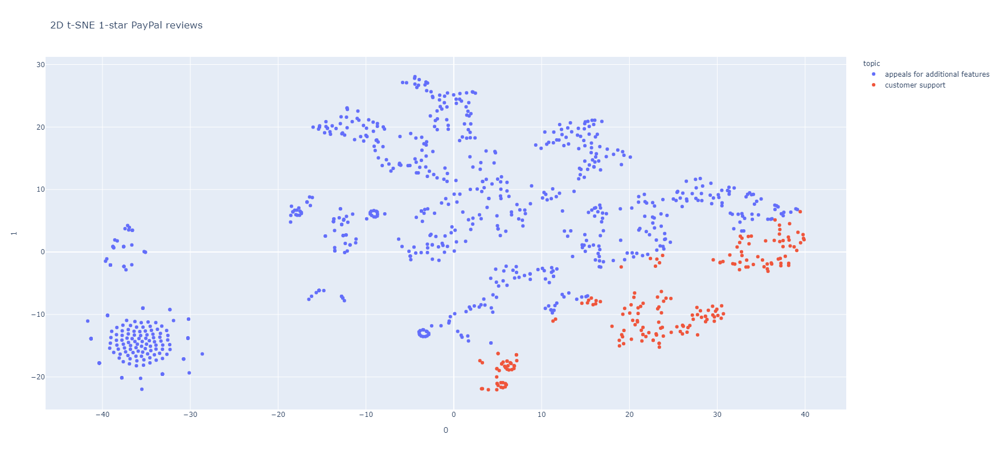

In [37]:
import matplotlib.colors as mcolors
from sklearn.manifold import TSNE
from itertools import cycle
from umap.umap_ import UMAP

# Array of topic weights    
arr = pd.DataFrame(predictions).fillna(0).values

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

topic_lst = set(topic_num)
new_topics = []

for i in topic_lst:
    new_topics.append(topics[i])
    
new_topics

# Topic colors
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])

tsne_model = TSNE(n_components=2, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter(
    projections, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='2D t-SNE 1-star PayPal reviews',
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_layout(width=1450, height=800)
fig.show()

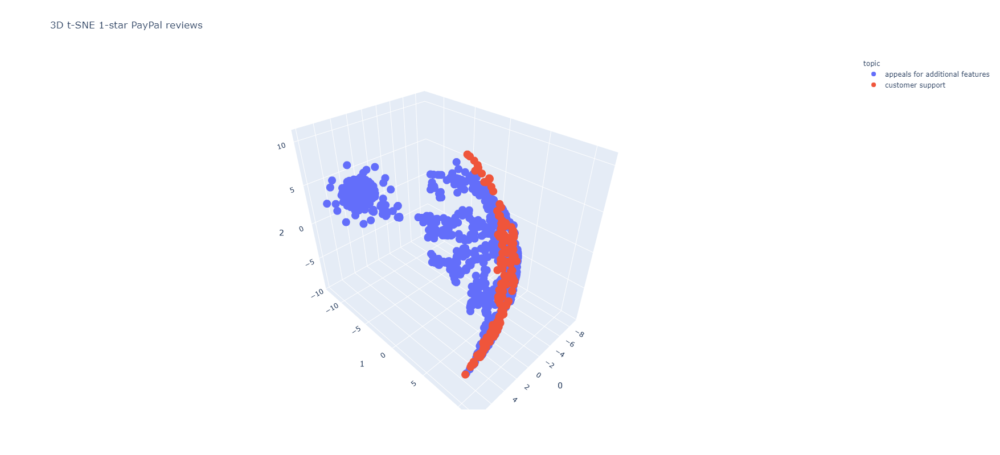

In [38]:
tsne_model = TSNE(n_components=3, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='3D t-SNE 1-star PayPal reviews'
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_traces(marker_size=8)
fig.update_layout(width=1450, height=800)
fig.show()

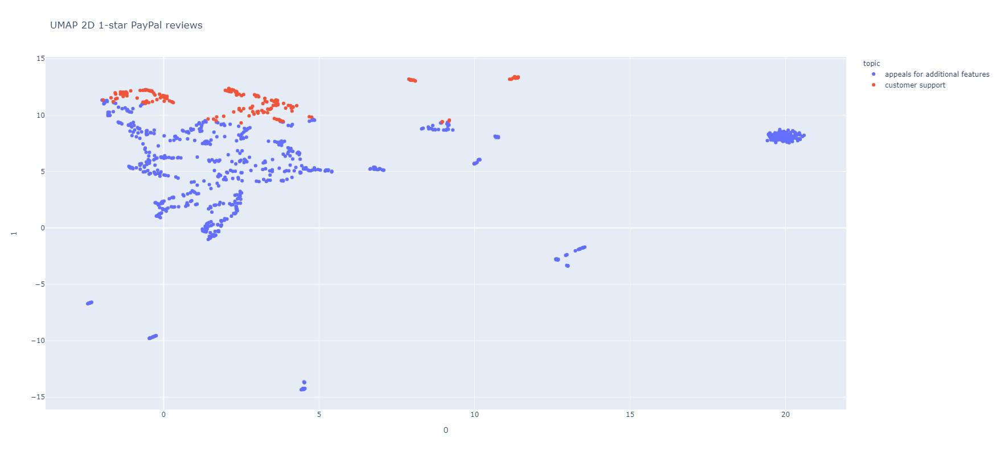

In [39]:
umap_2d = UMAP(n_components=2, random_state=0)
umap_3d = UMAP(n_components=3, random_state=0)

proj_2d = umap_2d.fit_transform(arr)
proj_3d = umap_3d.fit_transform(arr)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 2D 1-star PayPal reviews'
)
fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 3D 1-star PayPal reviews'
)
fig_3d.update_traces(marker_size=5)


labels = cycle(topics)

labels_2d = cycle(new_topics)
labels_3d = cycle(new_topics)

fig_2d.for_each_trace(lambda t:  t.update(name = next(labels_2d)))
fig_3d.for_each_trace(lambda t:  t.update(name = next(labels_3d)))
fig_2d.update_layout(width=1450, height=800)
fig_2d.show()

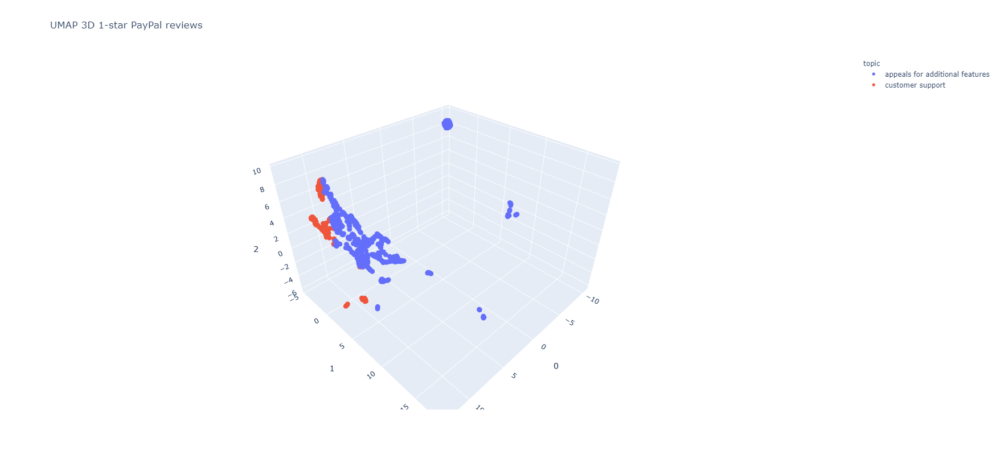

In [40]:
fig_3d.update_layout(width=1450, height=800)
fig_3d.show()

In [240]:
count = 10

print(f'\noriginal text:')
for i in range(count):
    print(f'\n{[i]} - {test_data.review.values.tolist()[i]}')


original text:

[0] - I cant log in

[1] - I just started using this app, when i confirm my email address they said my password is wrong but it isn't, i tried to verify it many times but the result still the same

[2] - Can't change the nber on my account in the app so I logged in through google to do it and withdraw my money but I still can't get into my account on the app because it just says my number isn't a valid format. This app is a joke.

[3] - Still experiencing problems

[4] - Useless. Never again. Do not trust it. Functioned poorly

[5] - save for buyer, not save for sellerr

[6] - The updated version is bad. the app is not locked the security is poor

[7] - My friend accidentally sent me birthday money under goods and services. They are now holding hundreds of dollars for "suspicious activity" but can't give the exact reason. Only way to resolve this is by snail mail according to their no help customer service.

[8] - This frickin thing has like a thousand problems that ke

In [241]:
test_counts = pd.DataFrame(
    test_vectors[:count],
    columns=vocab_list
)

print(display(test_counts))

,able,absolutely,accept,access,account,address,allow,anyone,apps,ask,bad,balance,bank,business,call,card,cash,center,change,charge,check,close,code,company,confirm,contact,crash,credit,customer,debit,delete,download,email,error,ever,experience,fee,friend,fund,game,good,hard,hate,help,hold,horrible,hour,info,information,issue,lock,log,login,lose,money,number,online,option,password,payment,people,person,play,poor,problem,purchase,reason,receive,recommend,refund,request,right,scam,security,sell,seller,send,sent,service,sign,slow,someone,stupid,suck,support,tell,terrible,time,told,transaction,transfer,update,useless,verify,wait,waste,website,week,withdraw,work
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

None


Text(0.5, 0, 'Topic ID')

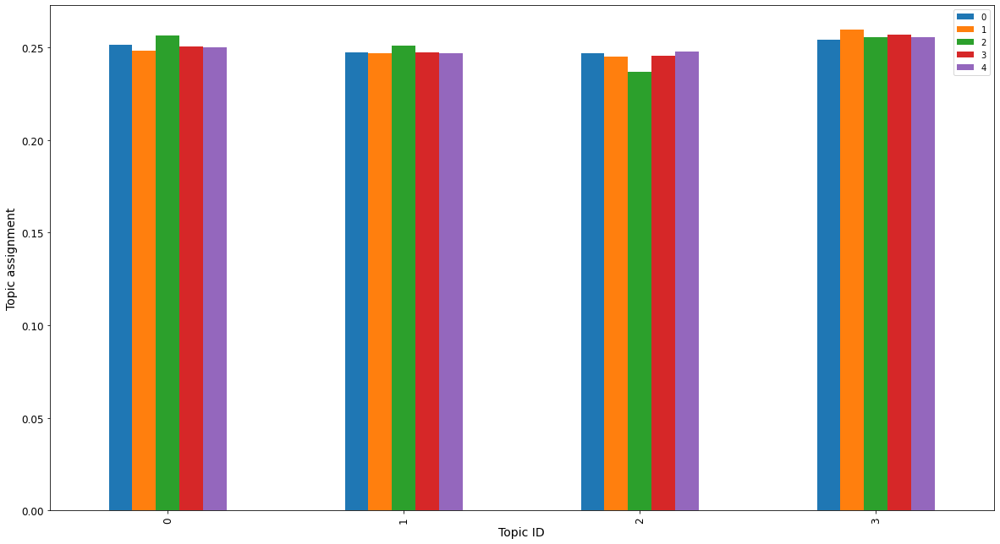

In [242]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

fs = 12
df=pd.DataFrame(predictions[:5].T)
df.plot(kind='bar', figsize=(20, 11), fontsize=fs)
plt.ylabel('Topic assignment', fontsize=fs+2)
plt.xlabel('Topic ID', fontsize=fs+2)

## Delete endpoint after performing inferences
---

In [248]:
sagemaker.Session().delete_endpoint(ntm_predictor.endpoint_name)

2021-07-02 03:49:54,171 | INFO | session.py:3023 | delete_endpoint | Deleting endpoint with name: ntm-2021-07-02-03-30-35-611


## Load model artifacts stored in output directory
---

In [243]:
model_path = os.path.join(output_prefix, ntm._current_job_name, "output/model.tar.gz")
model_path

'sagemaker/regalado/output/ntm-2021-07-02-03-26-22-847/output/model.tar.gz'

In [244]:
boto3.resource("s3").Bucket(bucket).download_file(model_path, "downloaded_model.tar.gz")

In [245]:
!pwd

/home/ec2-user/SageMaker/my-experiments


In [246]:
tarfile.open('downloaded_model.tar.gz').extractall()

with zipfile.ZipFile('model_algo-1', 'r') as zip_ref:
    zip_ref.extractall('./')
    
model = mx.ndarray.load("params")
W = model["arg:projection_weight"]

## Model exploration
---

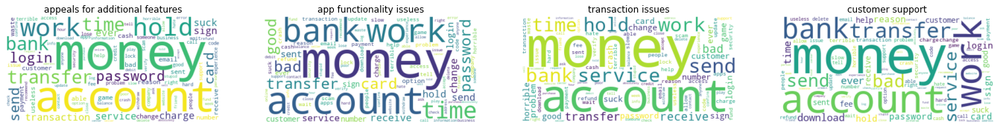

In [247]:
word_to_id = dict()

for i, v in enumerate(vocab_list):
    word_to_id[v] = i

limit = 30
n_col = 5
counter = 0

plt.figure(figsize=(30, 20))

for ind in range(num_topics):

    if counter >= limit:
        break
        
    title_str = topics[ind]
    pvals = mx.nd.softmax(mx.nd.array(W[:, ind])).asnumpy()
    word_freq = dict()
    
    for k in word_to_id.keys():
        i = word_to_id[k]
        word_freq[k] = pvals[i]

    wordcloud = wc.WordCloud(background_color="white").fit_words(word_freq)

    plt.subplot(limit // n_col, n_col, counter + 1)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(title_str)

    counter += 1

## 5-star model
---

In [294]:
sesh = sagemaker.Session()

ntm = sagemaker.estimator.Estimator(
    container,
    role, 
    instance_count=1, 
    instance_type='ml.m4.xlarge', # Free-tier instance (Free Tier usage per month for the first 2 months) ~ https://aws.amazon.com/sagemaker/pricing/
    output_path=output_path,
    sagemaker_session=sesh
)

# Best config ~ ~ ~ ~ ~ ~ 
# sigmoid	0.000427	566.0	adadelta	0.792179	0.406339
# relu	0.002450	353.0	adam	0.686733	0.225426

num_topics = 2

ntm.set_hyperparameters(
    num_topics=num_topics, 
    feature_dim=vocab_size, 
    num_patience_epochs=5,
#     tolerance=0.0001,
    epochs=100, 
    batch_norm=True,
    sub_sample=0.2,
    encoder_layers_activation='relu',
    learning_rate=0.002450,
    mini_batch_size=353,
    optimizer='adam',
    rescale_gradient=0.686733,
    weight_decay=0.225426
)

In [301]:
print(f'vocab size = {vocab_size}')
print(f'topic count = {num_topics}')
# print(f'\nplatform: {main_df.type.values[0]}\nrating: {main_df.rating.values[0]}')

vocab size = 100
topic count = 2


In [302]:
# WETC - The word embedding topic coherence metric measures the similarity of words in a topic by using a pre-trained word embedding, Glove-6B-400K-50d.
# TU - The topic unicity tells us how unique the word groups per topic are used overall (i.e. Are these meaningful words?)
# Note: A high (closer to 1) TU represents a high topic uniqueness for the topics detected.
# A high WETC value indicates a higher degree of topic coherence. A typical value would be in the range of 0.2 to 0.8

ntm.fit(inputs={"train": s3_train, "validation": s3_valid, "auxiliary": s3_aux_path})

2021-07-02 04:47:09,213 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: latest.
2021-07-02 04:47:09,224 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.
2021-07-02 04:47:09,225 | INFO | session.py:570 | train | Creating training-job with name: ntm-2021-07-02-04-47-09-212


2021-07-02 04:47:09 Starting - Starting the training job...
2021-07-02 04:47:33 Starting - Launching requested ML instancesProfilerReport-1625201229: InProgress
...
2021-07-02 04:48:08 Starting - Preparing the instances for training.........
2021-07-02 04:49:33 Downloading - Downloading input data...
2021-07-02 04:49:53 Training - Downloading the training image..Docker entrypoint called with argument(s): train
Running default environment configuration script
/opt/amazon/lib/python3.7/site-packages/jsonref.py:8: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping, MutableMapping, Sequence
[07/02/2021 04:50:23 INFO 139701293090624] Reading default configuration from /opt/amazon/lib/python3.7/site-packages/algorithm/default-input.json: {'encoder_layers': 'auto', 'mini_batch_size': '256', 'epochs': '50', 'encoder_layers_activation': 'sigmoid', 'o

## Deploy endpoint
---

In [303]:
ntm_predictor = ntm.deploy(initial_instance_count=1, instance_type='ml.m4.xlarge', wait=False)

2021-07-02 04:51:23,111 | INFO | session.py:2552 | create_model | Creating model with name: ntm-2021-07-02-04-51-23-056
2021-07-02 04:51:23,715 | INFO | session.py:2973 | create_endpoint | Creating endpoint with name ntm-2021-07-02-04-51-23-056


## Perform sample inferences
---

In [304]:
test_vectors.shape

(16670, 100)

In [319]:
from sagemaker.serializers import CSVSerializer
from sagemaker.deserializers import JSONDeserializer

count = 1000

# 5-star 
topics = ['positive user experience', 'positive user experience']

predictor = sagemaker.predictor.Predictor(
    endpoint_name=ntm_predictor.endpoint_name, 
    sagemaker_session=sesh, 
    serializer=CSVSerializer(), 
    deserializer=JSONDeserializer()
)

# predictor.update_endpoint()

results = predictor.predict(train_vectors[:count])
print(f'Raw prediction/s:\n{results}')

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])
print(f'\nPredicted topic weights:\n{predictions}\n\nSorted topic assignment scores per input document:')

for i in results['predictions']:
    sorted_indexes = np.argsort(i['topic_weights']).tolist()
    sorted_indexes.reverse()
    top_topics = [topics[j] for j in sorted_indexes]
    top_weights = [i['topic_weights'][j] for j in sorted_indexes]
    pairs = list(zip(top_topics, top_weights))
    print(pairs)

Raw prediction/s:
{'predictions': [{'topic_weights': [0.4979776144, 0.5020224452]}, {'topic_weights': [0.496224612, 0.5037754178]}, {'topic_weights': [0.4967926145, 0.5032073855]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4987561107, 0.5012438893]}, {'topic_weights': [0.5027608871, 0.4972391129]}, {'topic_weights': [0.4967322052, 0.503267765]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4968185723, 0.5031813979]}, {'topic_weights': [0.4964998066, 0.5035002232]}, {'topic_weights': [0.4969605505, 0.5030394793]}, {'topic_weights': [0.4968111813, 0.5031887889]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4971245229, 0.5028755069]}, {'topic_weights': [0.5007231236, 0.49927

In [31]:
results = {'predictions': [{'topic_weights': [0.4979776144, 0.5020224452]}, {'topic_weights': [0.496224612, 0.5037754178]}, {'topic_weights': [0.4967926145, 0.5032073855]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4987561107, 0.5012438893]}, {'topic_weights': [0.5027608871, 0.4972391129]}, {'topic_weights': [0.4967322052, 0.503267765]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4968185723, 0.5031813979]}, {'topic_weights': [0.4964998066, 0.5035002232]}, {'topic_weights': [0.4969605505, 0.5030394793]}, {'topic_weights': [0.4968111813, 0.5031887889]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4971245229, 0.5028755069]}, {'topic_weights': [0.5007231236, 0.4992769063]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4967772961, 0.5032227039]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5068282485, 0.4931717217]}, {'topic_weights': [0.5011234283, 0.4988765717]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4964998066, 0.5035002232]}, {'topic_weights': [0.4959003031, 0.5040996671]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.5005736351, 0.4994263947]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5000423789, 0.4999576509]}, {'topic_weights': [0.4969605505, 0.5030394793]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4951043129, 0.5048956871]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.496827364, 0.503172636]}, {'topic_weights': [0.5012391806, 0.4987608194]}, {'topic_weights': [0.4961916804, 0.5038083196]}, {'topic_weights': [0.5009164214, 0.4990836084]}, {'topic_weights': [0.5006130934, 0.4993869364]}, {'topic_weights': [0.5002566576, 0.4997433722]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4973593056, 0.5026406646]}, {'topic_weights': [0.5026815534, 0.4973184168]}, {'topic_weights': [0.49682495, 0.5031750798]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967594445, 0.5032405853]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4995535612, 0.5004464388]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4962249398, 0.5037750602]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5009164214, 0.4990836084]}, {'topic_weights': [0.4967871904, 0.5032128096]}, {'topic_weights': [0.4967698157, 0.5032302141]}, {'topic_weights': [0.4967963994, 0.5032036304]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.497716397, 0.5022836328]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4965445995, 0.5034554005]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5009562373, 0.4990437627]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967599809, 0.5032399893]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4968105853, 0.5031894445]}, {'topic_weights': [0.4968212545, 0.5031787157]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4995564222, 0.5004436374]}, {'topic_weights': [0.496822238, 0.503177762]}, {'topic_weights': [0.49679178, 0.50320822]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.495139271, 0.5048607588]}, {'topic_weights': [0.4967414439, 0.5032585263]}, {'topic_weights': [0.5040208101, 0.4959792197]}, {'topic_weights': [0.4972612262, 0.5027387738]}, {'topic_weights': [0.4988268912, 0.501173079]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5024579167, 0.4975421131]}, {'topic_weights': [0.4968011081, 0.5031989217]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4967576563, 0.5032423139]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967297912, 0.5032702088]}, {'topic_weights': [0.4967822134, 0.5032178164]}, {'topic_weights': [0.4968036711, 0.5031963587]}, {'topic_weights': [0.5040208101, 0.4959792197]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967394471, 0.5032605529]}, {'topic_weights': [0.4976613224, 0.5023387074]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4980996847, 0.5019003749]}, {'topic_weights': [0.4987876117, 0.5012123585]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5015098453, 0.4984901547]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4973593056, 0.5026406646]}, {'topic_weights': [0.4962249398, 0.5037750602]}, {'topic_weights': [0.4965381324, 0.5034618378]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5035924315, 0.4964075983]}, {'topic_weights': [0.504981041, 0.495018959]}, {'topic_weights': [0.5008320808, 0.499167949]}, {'topic_weights': [0.4951043129, 0.5048956871]}, {'topic_weights': [0.4967573583, 0.5032426715]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4997896552, 0.5002103448]}, {'topic_weights': [0.4967840016, 0.5032159686]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967355132, 0.5032644868]}, {'topic_weights': [0.5015098453, 0.4984901547]}, {'topic_weights': [0.4967456162, 0.503254354]}, {'topic_weights': [0.4977572858, 0.502242744]}, {'topic_weights': [0.5009164214, 0.4990836084]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4975679517, 0.5024320483]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4967872202, 0.50321275]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4968028963, 0.5031970739]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4967466295, 0.5032533407]}, {'topic_weights': [0.4968097806, 0.5031902194]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4967389703, 0.5032610297]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5005869269, 0.4994131029]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4967559278, 0.5032440424]}, {'topic_weights': [0.4967625439, 0.5032374263]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.5040208101, 0.4959792197]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5007231236, 0.4992769063]}, {'topic_weights': [0.4968046844, 0.5031952858]}, {'topic_weights': [0.4959862232, 0.5040137768]}, {'topic_weights': [0.4956766963, 0.5043233037]}, {'topic_weights': [0.5037028193, 0.4962971807]}, {'topic_weights': [0.4962540269, 0.5037459135]}, {'topic_weights': [0.4968495667, 0.5031504035]}, {'topic_weights': [0.4967554808, 0.5032445192]}, {'topic_weights': [0.4965320826, 0.5034679174]}, {'topic_weights': [0.5016376972, 0.4983623326]}, {'topic_weights': [0.4967491031, 0.5032508969]}, {'topic_weights': [0.4973734319, 0.5026265383]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4972431064, 0.5027568936]}, {'topic_weights': [0.4967715144, 0.5032284856]}, {'topic_weights': [0.5008838773, 0.4991161525]}, {'topic_weights': [0.5034644604, 0.4965355396]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4966974854, 0.5033025146]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.4945427775, 0.5054571629]}, {'topic_weights': [0.495139271, 0.5048607588]}, {'topic_weights': [0.4968225956, 0.5031774044]}, {'topic_weights': [0.5020661354, 0.4979338646]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5020956397, 0.4979043901]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4967602789, 0.5032397509]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.4966772497, 0.5033227801]}, {'topic_weights': [0.4967532456, 0.5032467246]}, {'topic_weights': [0.5052351952, \
0.4947648346]}, {'topic_weights': [0.5010107756, 0.4989892542]}, {'topic_weights': [0.4967519939, 0.5032480359]}, {'topic_weights': [0.4967327714, 0.5032672286]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5037062168, 0.4962938428]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4945411384, 0.5054588914]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4963065982, 0.5036933422]}, {'topic_weights': [0.5015098453, 0.4984901547]}, {'topic_weights': [0.5015843511, 0.4984156191]}, {'topic_weights': [0.5009260178, 0.499074012]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4967722297, 0.5032277703]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.496378988, 0.5036209822]}, {'topic_weights': [0.4977572858, 0.502242744]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4994007945, 0.5005992055]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967724383, 0.5032275319]}, {'topic_weights': [0.5052180886, 0.4947819114]}, {'topic_weights': [0.4968699813, 0.5031300783]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4960094988, 0.5039904714]}, {'topic_weights': [0.496774137, 0.503225863]}, {'topic_weights': [0.496378988, 0.5036209822]}, {'topic_weights': [0.4968066812, 0.5031933188]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967362285, 0.5032637715]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967471957, 0.5032528043]}, {'topic_weights': [0.4958226085, 0.5041773915]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967727959, 0.5032272339]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967686236, 0.5032313466]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4951043129, 0.5048956871]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.4983520806, 0.5016478896]}, {'topic_weights': [0.4967442453, 0.5032557249]}, {'topic_weights': [0.500874877, 0.4991251826]}, {'topic_weights': [0.4966766536, 0.5033233762]}, {'topic_weights': [0.4957405329, 0.5042594671]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967699349, 0.5032300353]}, {'topic_weights': [0.4963079393, 0.5036920905]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5046573281, 0.4953427017]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4995535612, 0.5004464388]}, {'topic_weights': [0.496776402, 0.503223598]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.496534735, 0.5034652948]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4984025657, 0.5015974045]}, {'topic_weights': [0.4969605505, 0.5030394793]}, {'topic_weights': [0.5003695488, 0.4996304512]}, {'topic_weights': [0.4946652949, 0.5053346753]}, {'topic_weights': [0.4965211749, 0.5034788251]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4949606955, 0.5050393343]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4987119436, 0.5012880564]}, {'topic_weights': [0.4961002469, 0.5038997531]}, {'topic_weights': [0.4967722297, 0.5032277703]}, {'topic_weights': [0.4967587888, 0.5032411814]}, {'topic_weights': [0.4980751276, 0.5019248724]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967654645, 0.5032345057]}, {'topic_weights': [0.4965073466, 0.5034926534]}, {'topic_weights': [0.4953646362, 0.504635334]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4968091249, 0.5031908751]}, {'topic_weights': [0.4967958927, 0.5032041073]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.501108408, 0.4988916218]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967746437, 0.5032253861]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967470467, 0.5032529235]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.499679029, 0.500320971]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4967961013, 0.5032039285]}, {'topic_weights': [0.4967322052, 0.503267765]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967733324, 0.5032266974]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5009562373, 0.4990437627]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967329502, 0.5032670498]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967784882, 0.5032215118]}, {'topic_weights': [0.4968321323, 0.5031679273]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4972333908, 0.5027666092]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4967859387, 0.5032140017]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967690408, 0.5032309294]}, {'topic_weights': [0.4969729483, 0.5030270815]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4967500269, 0.5032499433]}, {'topic_weights': [0.4998773932, 0.5001226068]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967599213, 0.5032400489]}, {'topic_weights': [0.4983654022, 0.5016345978]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4984835088, 0.501516521]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.5029419661, 0.4970580637]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4960771799, 0.5039227605]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4965320826, 0.5034679174]}, {'topic_weights': [0.505286932, 0.4947130978]}, {'topic_weights': [0.4967530668, 0.5032469034]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4994184971, 0.5005815029]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4968699813, 0.5031300783]}, {'topic_weights': [0.4967606962, 0.5032393336]}, {'topic_weights': [0.5018424988, 0.4981574416]}, {'topic_weights': [0.5045816302, 0.49541834]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5056139827, 0.4943860173]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4968229532, 0.5031770468]}, {'topic_weights': [0.4965161681, 0.5034837723]}, {'topic_weights': [0.4968289137, 0.5031710267]}, {'topic_weights': [0.4967329502, 0.5032670498]}, {'topic_weights': [0.4967339039, 0.5032661557]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4971267581, 0.5028732419]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5017532706, 0.4982467294]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967906475, 0.5032092929]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4967841208, 0.503215909]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.496823132, 0.5031769276]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.504321754, 0.4956781864]}, {'topic_weights': [0.5009915829, 0.4990083873]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5027035475, 0.4972964227]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4972333908, 0.5027666092]}, {'topic_weights': [0.4968438447, 0.5031561852]}, {'topic_weights': [0.5008895397, 0.4991104603]}, {'topic_weights': [0.4967314899, 0.5032685399]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4962049425, 0.5037950873]}, {'topic_weights': [0.5037062168, 0.4962938428]}, {'topic_weights': [0.4951664507, 0.5048335195]}, {'topic_weights': [0.496776402, 0.5032235384]}, {'topic_weights': [0.5056375861, 0.4943624735]}, {'topic_weights': [0.5034140348, 0.4965859056]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4993240833, 0.5006758571]}, {'topic_weights': [0.4967681468, 0.503231883]}, {'topic_weights': [0.5009553432, 0.4990446568]}, \
{'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967904985, 0.5032094717]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.5017532706, 0.4982467294]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4968358278, 0.5031641722]}, {'topic_weights': [0.4967433214, 0.5032566786]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4969394803, 0.5030604601]}, {'topic_weights': [0.4994184971, 0.5005815029]}, {'topic_weights': [0.4970898032, 0.5029101968]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4967659414, 0.5032340884]}, {'topic_weights': [0.4962249398, 0.5037750602]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5005182028, 0.499481827]}, {'topic_weights': [0.4969132543, 0.5030867457]}, {'topic_weights': [0.4958322346, 0.5041677952]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967783391, 0.5032216311]}, {'topic_weights': [0.4967549145, 0.5032451153]}, {'topic_weights': [0.4994184971, 0.5005815029]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5033306479, 0.4966693223]}, {'topic_weights': [0.4967941046, 0.503205955]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4964559078, 0.5035440326]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.5020661354, 0.4979338646]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.501108408, 0.4988916218]}, {'topic_weights': [0.49673599, 0.50326401]}, {'topic_weights': [0.4968296587, 0.5031703115]}, {'topic_weights': [0.4946847856, 0.5053152442]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967983663, 0.5032016039]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5006272197, 0.4993727505]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967828393, 0.5032171607]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4968271852, 0.5031728148]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967701137, 0.5032298565]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967815876, 0.5032184124]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967857301, 0.5032142401]}, {'topic_weights': [0.5037062168, 0.4962938428]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.5025589466, 0.497441113]}, {'topic_weights': [0.4967870116, 0.5032129884]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.496794343, 0.503205657]}, {'topic_weights': [0.4953051805, 0.5046948791]}, {'topic_weights': [0.5015843511, 0.4984156191]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4968166649, 0.5031833053]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4968215525, 0.5031784177]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5031414628, 0.496858567]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4965850115, 0.5034149885]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4969307184, 0.5030692816]}, {'topic_weights': [0.4968147576, 0.5031852126]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967923462, 0.5032076836]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4962249398, 0.5037750602]}, {'topic_weights': [0.4967724383, 0.5032275319]}, {'topic_weights': [0.4948385954, 0.5051614046]}, {'topic_weights': [0.4967698157, 0.5032301545]}, {'topic_weights': [0.4962504208, 0.503749609]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5035699606, 0.4964300394]}, {'topic_weights': [0.4967340231, 0.5032660365]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.496755898, 0.503244102]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4968016446, 0.5031983852]}, {'topic_weights': [0.4967704713, 0.5032295585]}, {'topic_weights': [0.4967727959, 0.5032272339]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4989852607, 0.5010147095]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4962249398, 0.5037750602]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967724383, 0.5032275319]}, {'topic_weights': [0.4965409935, 0.5034590364]}, {'topic_weights': [0.496784687, 0.5032153726]}, {'topic_weights': [0.5033102632, 0.4966896772]}, {'topic_weights': [0.496534735, 0.5034652948]}, {'topic_weights': [0.4963462353, 0.5036538243]}, {'topic_weights': [0.5014441609, 0.4985558093]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5002812147, 0.4997188151]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4968699813, 0.5031300783]}, {'topic_weights': [0.4967552125, 0.5032448173]}, {'topic_weights': [0.5010530949, 0.4989469349]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4996293783, 0.5003706813]}, {'topic_weights': [0.4972903728, 0.5027096272]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.496032685, 0.5039672852]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967474341, 0.5032525659]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4966115952, 0.5033884048]}, {'topic_weights': [0.4968250692, 0.5031749606]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.4967539907, 0.5032460093]}, {'topic_weights': [0.4957405329, 0.5042594671]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967800975, 0.5032199621]}, {'topic_weights': [0.4985326231, 0.5014674067]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4993246794, 0.500675261]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5005807877, 0.4994192123]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.500629425, 0.499370575]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.5074647665, 0.4925352335]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4997152388, 0.500284791]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.4967894852, 0.5032105446]}, {'topic_weights': [0.5049363971, 0.4950636029]}, {'topic_weights': [0.4962095916, 0.5037903786]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4981563091, 0.5018436909]}, {'topic_weights': [0.5033102632, 0.4966896772]}, {'topic_weights': [0.4981653094, 0.5018346906]}, {'topic_weights': [0.4965445995, 0.5034554005]}, {'topic_weights': [0.5068282485, 0.4931717217]}, {'topic_weights': [0.495788455, 0.504211545]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4968101382, 0.5031898618]}, {'topic_weights': [0.4967773855, 0.5032226443]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5046152472, 0.4953847528]}, {'topic_weights': [0.5037783384, 0.4962216616]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5033102632, 0.4966896772]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4959003031, 0.5040996671]}, {'topic_weights': [0.4967767298, 0.5032232404]}, {'topic_weights': [0.4968090653, 0.5031908751]}, {'topic_weights': [0.4967662692, 0.5032337904]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5015098453, 0.4984901547]}, {'topic_weights': [0.5025146604, 0.4974853694]}, {'topic_weights': [0.4972267449, 0.5027732849]}, {'topic_weights': [0.4977439344, 0.5022560954]}, {'topic_weights': [0.499940902, 0.5000590682]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.5007634163, 0.4992365837]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.5009164214, 0.4990836084]}, {'topic_weights': [0.4987876117, 0.5012123585]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5006185174, 0.4993814528]}, {'topic_weights': [0.4967692792, 0.5032307506]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967329502, 0.5032670498]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4967340231, 0.5032660365]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': \
[0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967738092, 0.503226161]}, {'topic_weights': [0.4994854033, 0.5005145669]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967759252, 0.5032241344]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4977572858, 0.502242744]}, {'topic_weights': [0.496592015, 0.5034080148]}, {'topic_weights': [0.4967758656, 0.5032241344]}, {'topic_weights': [0.4984098077, 0.5015901923]}, {'topic_weights': [0.4965320826, 0.5034679174]}, {'topic_weights': [0.5012389421, 0.4987610281]}, {'topic_weights': [0.4967988729, 0.5032011867]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4968699813, 0.5031300783]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4968125224, 0.5031874776]}, {'topic_weights': [0.4967861176, 0.5032138824]}, {'topic_weights': [0.4967987537, 0.5032013059]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967875779, 0.5032123923]}, {'topic_weights': [0.5015843511, 0.4984156191]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5000855327, 0.4999144971]}, {'topic_weights': [0.4974112511, 0.5025887489]}, {'topic_weights': [0.4968226552, 0.5031773448]}, {'topic_weights': [0.4967754483, 0.5032246113]}, {'topic_weights': [0.5023026466, 0.4976973236]}, {'topic_weights': [0.496748507, 0.503251493]}, {'topic_weights': [0.4959862232, 0.5040137768]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4968438447, 0.5031561852]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5037062168, 0.4962938428]}, {'topic_weights': [0.5025238991, 0.4974761605]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4951043129, 0.5048956871]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.5025589466, 0.497441113]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4991855919, 0.5008143783]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4969359636, 0.5030640364]}, {'topic_weights': [0.5016583204, 0.4983417094]}, {'topic_weights': [0.5009260178, 0.499074012]}, {'topic_weights': [0.4967297912, 0.5032702088]}, {'topic_weights': [0.4973558486, 0.5026441216]}, {'topic_weights': [0.4959862232, 0.5040137768]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967415631, 0.5032584071]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4968495667, 0.5031504035]}, {'topic_weights': [0.4967952967, 0.5032047033]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4968699813, 0.5031300783]}, {'topic_weights': [0.4959653914, 0.5040345788]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.500154376, 0.4998456538]}, {'topic_weights': [0.4967637956, 0.5032361746]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5033102632, 0.4966896772]}, {'topic_weights': [0.4967495501, 0.5032504797]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.496830821, 0.503169179]}, {'topic_weights': [0.4959862232, 0.5040137768]}, {'topic_weights': [0.4967652261, 0.5032347441]}, {'topic_weights': [0.4967736006, 0.5032263994]}, {'topic_weights': [0.4967314899, 0.5032685399]}, {'topic_weights': [0.4962278008, 0.5037721992]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5012664795, 0.4987335205]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4958219528, 0.5041780472]}, {'topic_weights': [0.4967514575, 0.5032485127]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5021419525, 0.4978579879]}, {'topic_weights': [0.4966248274, 0.5033751726]}, {'topic_weights': [0.4968157709, 0.5031842589]}, {'topic_weights': [0.502150774, 0.4978492856]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967832267, 0.5032168031]}, {'topic_weights': [0.497836709, 0.502163291]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.496732384, 0.5032675862]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967410862, 0.5032589436]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.494998306, 0.5050017238]}, {'topic_weights': [0.5022487044, 0.4977512658]}, {'topic_weights': [0.5002407432, 0.4997592568]}, {'topic_weights': [0.5015843511, 0.4984156191]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4967423975, 0.5032575727]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5046284795, 0.4953715205]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.495987922, 0.5040121078]}, {'topic_weights': [0.4962249398, 0.5037750602]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4967910051, 0.5032089353]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4976877868, 0.502312243]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4964396358, 0.5035603046]}, {'topic_weights': [0.4965409935, 0.5034590364]}, {'topic_weights': [0.4969638586, 0.5030361414]}, {'topic_weights': [0.4969359636, 0.5030640364]}, {'topic_weights': [0.5009915829, 0.4990083873]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5003909469, 0.4996090531]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4968699813, 0.5031300783]}, {'topic_weights': [0.4989612401, 0.5010387897]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5023766756, 0.4976233244]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5071428418, 0.4928571284]}, {'topic_weights': [0.4967913032, 0.5032086372]}, {'topic_weights': [0.4967314899, 0.5032685399]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4965148568, 0.5034851432]}, {'topic_weights': [0.4969132543, 0.5030867457]}, {'topic_weights': [0.5015098453, 0.4984901547]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4966974854, 0.5033025146]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.5034416318, 0.4965584278]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4967669547, 0.5032330155]}, {'topic_weights': [0.4967340231, 0.5032660365]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5040208101, 0.4959792197]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4967681468, 0.503231883]}, {'topic_weights': [0.4967914522, 0.5032085776]}, {'topic_weights': [0.4962249398, 0.5037750602]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967907071, 0.5032092929]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.4967759252, 0.5032241344]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967491627, 0.5032507777]}, {'topic_weights': [0.4967963994, 0.5032036304]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4977572858, 0.502242744]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967861176, 0.5032138228]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967744052, 0.503225565]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.5000855327, 0.4999144971]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4968034625, 0.5031965375]}, {'topic_weights': [0.4957993925, 0.5042006373]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5015098453, 0.4984901547]}, {'topic_weights': [0.4961608946, \
0.5038390756]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4958219528, 0.5041780472]}, {'topic_weights': [0.500154376, 0.4998456538]}, {'topic_weights': [0.4977572858, 0.502242744]}, {'topic_weights': [0.4951043129, 0.5048956871]}, {'topic_weights': [0.496771276, 0.503228724]}, {'topic_weights': [0.496776253, 0.5032237172]}, {'topic_weights': [0.5071428418, 0.4928571284]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4967634082, 0.5032365918]}, {'topic_weights': [0.5002205372, 0.4997794628]}, {'topic_weights': [0.4967549741, 0.5032450557]}, {'topic_weights': [0.5000087023, 0.4999912977]}, {'topic_weights': [0.5037062168, 0.4962938428]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4968038499, 0.5031961799]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.5005182028, 0.499481827]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4959862232, 0.5040137768]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967438281, 0.5032561421]}, {'topic_weights': [0.4969638586, 0.5030361414]}, {'topic_weights': [0.5027369857, 0.4972630441]}, {'topic_weights': [0.496781528, 0.503218472]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4967559278, 0.503244102]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4965381324, 0.5034618378]}, {'topic_weights': [0.497590363, 0.502409637]}, {'topic_weights': [0.4977439344, 0.5022560954]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967824519, 0.5032175779]}, {'topic_weights': [0.4967852235, 0.5032147765]}, {'topic_weights': [0.4968115091, 0.5031884909]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5005429983, 0.4994570315]}, {'topic_weights': [0.4967884421, 0.5032115579]}, {'topic_weights': [0.4959149063, 0.5040850639]}, {'topic_weights': [0.495295465, 0.504704535]}, {'topic_weights': [0.4967926443, 0.5032073259]}, {'topic_weights': [0.5040208101, 0.4959792197]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4977572858, 0.502242744]}, {'topic_weights': [0.5009840131, 0.4990159273]}, {'topic_weights': [0.5009153485, 0.4990846813]}, {'topic_weights': [0.4968619347, 0.5031380653]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4969638586, 0.5030361414]}, {'topic_weights': [0.496781081, 0.5032188892]}, {'topic_weights': [0.5033102632, 0.4966896772]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967314899, 0.5032685399]}, {'topic_weights': [0.4967602789, 0.5032397509]}, {'topic_weights': [0.496802479, 0.5031974912]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5016528368, 0.4983471632]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967297912, 0.5032702088]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4968004823, 0.5031995177]}, {'topic_weights': [0.4969132543, 0.5030867457]}, {'topic_weights': [0.5010873079, 0.4989127517]}, {'topic_weights': [0.4968266785, 0.5031733513]}, {'topic_weights': [0.4967522919, 0.5032477379]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4968037307, 0.5031962991]}, {'topic_weights': [0.4968699813, 0.5031300783]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4968129992, 0.5031870008]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4996293783, 0.5003706813]}, {'topic_weights': [0.5037062168, 0.4962938428]}, {'topic_weights': [0.5033102632, 0.4966896772]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967546761, 0.5032453537]}, {'topic_weights': [0.4967875779, 0.5032123923]}, {'topic_weights': [0.4945411384, 0.5054588914]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.5033102632, 0.4966896772]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4970898032, 0.5029101968]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967740476, 0.5032259226]}, {'topic_weights': [0.4971984625, 0.5028015375]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4969132543, 0.5030867457]}, {'topic_weights': [0.4967670739, 0.5032328963]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5037062168, 0.4962938428]}, {'topic_weights': [0.496378988, 0.5036209822]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4974733591, 0.5025266409]}, {'topic_weights': [0.4957405329, 0.5042594671]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4967297912, 0.5032702088]}, {'topic_weights': [0.4967389703, 0.5032610297]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967806041, 0.5032194257]}, {'topic_weights': [0.496776998, 0.503223002]}, {'topic_weights': [0.4967871904, 0.5032128096]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4967419207, 0.5032581091]}, {'topic_weights': [0.4965320826, 0.5034679174]}, {'topic_weights': [0.4968280196, 0.5031719208]}, {'topic_weights': [0.5052545667, 0.4947454631]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4967893958, 0.5032106638]}, {'topic_weights': [0.4965211749, 0.5034788251]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4967699349, 0.5032300353]}, {'topic_weights': [0.4968356192, 0.503164351]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967789948, 0.5032209754]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4971267581, 0.5028732419]}, {'topic_weights': [0.4967732728, 0.503226757]}, {'topic_weights': [0.4984281361, 0.5015718937]}, {'topic_weights': [0.4967772663, 0.5032227039]}, {'topic_weights': [0.5025146604, 0.4974853694]}, {'topic_weights': [0.5036736727, 0.4963263869]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.5068611503, 0.4931388497]}, {'topic_weights': [0.496784389, 0.503215611]}, {'topic_weights': [0.5040208101, 0.4959792197]}, {'topic_weights': [0.4971057177, 0.5028942227]}, {'topic_weights': [0.4970334768, 0.5029665232]}, {'topic_weights': [0.4960771799, 0.5039227605]}, {'topic_weights': [0.4968288541, 0.5031711459]}, {'topic_weights': [0.4968696535, 0.5031303763]}, {'topic_weights': [0.4980965555, 0.5019034743]}, {'topic_weights': [0.4995535612, 0.5004464388]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.500574708, 0.499425292]}, {'topic_weights': [0.4968862832, 0.503113687]}, {'topic_weights': [0.4967319667, 0.5032680631]}, {'topic_weights': [0.49710235, 0.5028976798]}, {'topic_weights': [0.4965213239, 0.5034787059]}, {'topic_weights': [0.4947282672, 0.5052717328]}, {'topic_weights': [0.4974814951, 0.5025184751]}, {'topic_weights': [0.4967395663, 0.5032604337]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4971267581, 0.5028732419]}, {'topic_weights': [0.5003785491, 0.4996214807]}, {'topic_weights': [0.4970476329, 0.5029523373]}, {'topic_weights': [0.5021165013, 0.4978834987]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.5052351952, 0.4947648346]}, {'topic_weights': [0.495139271, 0.5048607588]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.4967638552, 0.5032361746]}, {'topic_weights': [0.4974447191, 0.5025552511]}, {'topic_weights': [0.494317174, 0.5056827664]}, {'topic_weights': [0.4959352016, 0.5040647984]}, {'topic_weights': [0.4967314899, 0.5032685399]}, {'topic_weights': [0.4947282672, 0.5052717328]}]}

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])

topics = ['positive user experience', 'positive user experience']

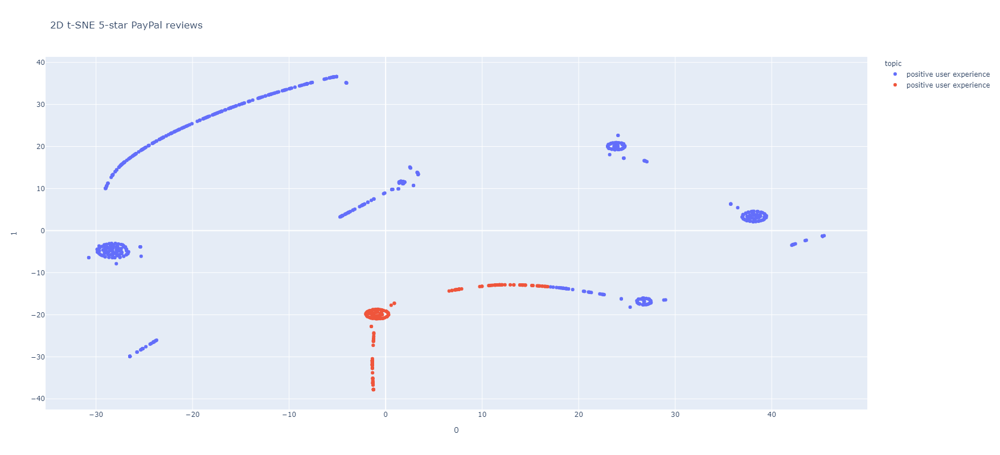

In [32]:
# Array of topic weights    
arr = pd.DataFrame(predictions).fillna(0).values

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

topic_lst = set(topic_num)
new_topics = []

for i in topic_lst:
    new_topics.append(topics[i])

# Topic colors
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])

tsne_model = TSNE(n_components=2, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter(
    projections, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='2D t-SNE 5-star PayPal reviews'
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_layout(width=1450, height=800)
fig.show()

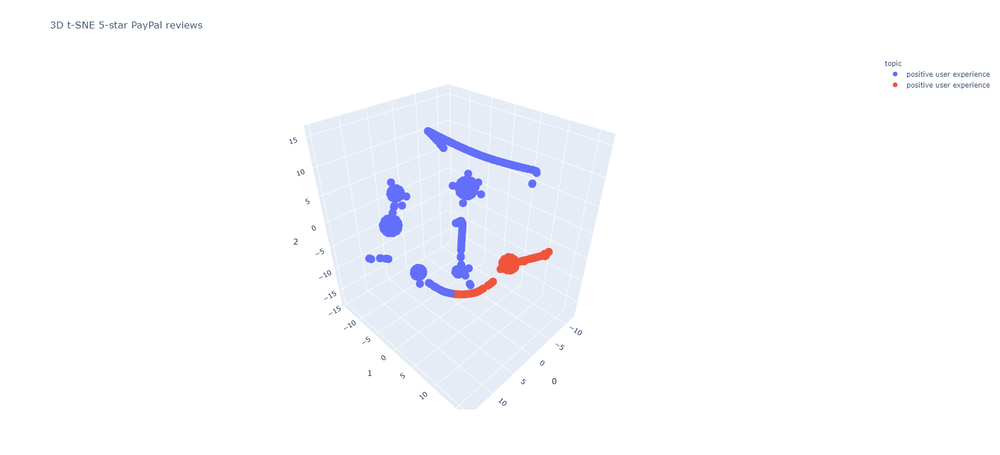

In [33]:
tsne_model = TSNE(n_components=3, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='3D t-SNE 5-star PayPal reviews'
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_traces(marker_size=8)
fig.update_layout(width=1450, height=800)
fig.show()

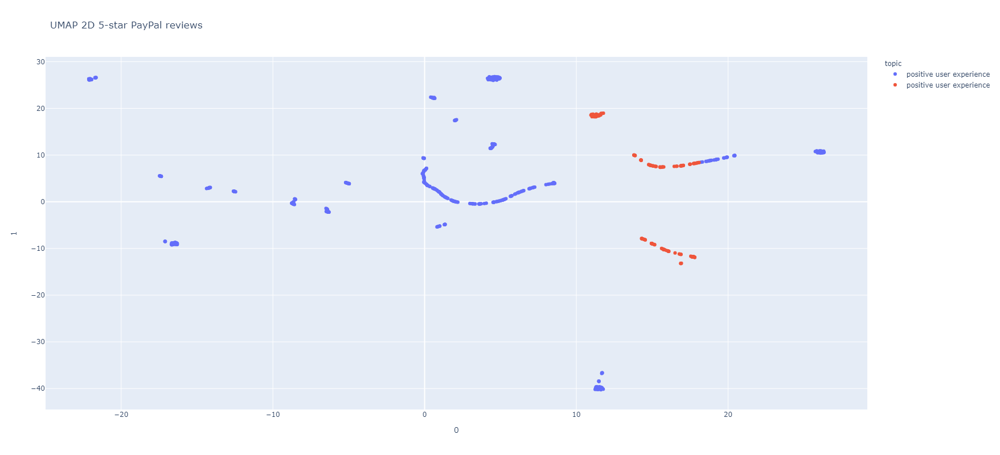

In [34]:
umap_2d = UMAP(n_components=2, random_state=0)
umap_3d = UMAP(n_components=3, random_state=0)

proj_2d = umap_2d.fit_transform(arr)
proj_3d = umap_3d.fit_transform(arr)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 2D 5-star PayPal reviews'
)
fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 3D 5-star PayPal reviews'
)
fig_3d.update_traces(marker_size=5)

labels_2d = cycle(new_topics)
labels_3d = cycle(new_topics)

fig_2d.for_each_trace(lambda t:  t.update(name = next(labels_2d)))
fig_3d.for_each_trace(lambda t:  t.update(name = next(labels_3d)))
fig_2d.update_layout(width=1450, height=800)
fig_2d.show()

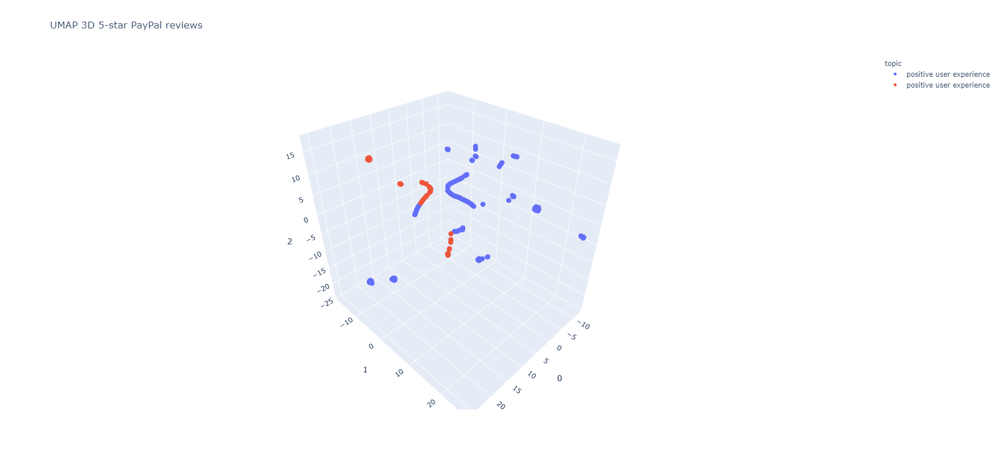

In [35]:
fig_3d.update_layout(width=1450, height=800)
fig_3d.show()

In [267]:
count = 10

print(f'\noriginal text:')
for i in range(count):
    print(f'\n{[i]} - {test_data.review.values.tolist()[i]}')


original text:

[0] - Magagamit ko yung PayPal sa cashzine ko

[1] - Awesome 👌

[2] - I can't seem to get the app on my phone

[3] - Good

[4] - Good job !

[5] - Awhsome

[6] - Awesome Every Time..

[7] - User friendly and easy to use

[8] - Good

[9] - Easiest to use so far.


In [268]:
test_counts = pd.DataFrame(
    test_vectors[:count],
    columns=vocab_list
)

print(display(test_counts))

,able,absolutely,access,account,amaze,anyone,application,apps,awesome,bank,banking,best,bill,brilliant,business,card,cash,charge,check,convenience,convenient,cool,credit,customer,debit,ease,easily,easy,efficient,enjoy,ever,excellent,experience,family,fantastic,fast,feature,fee,feel,free,friend,friendly,fund,game,good,great,handy,happy,hassle,help,helpful,highly,issue,little,love,mobile,money,navigate,nice,online,option,paid,pay,payment,peasy,people,perfect,pretty,problem,purchase,quick,quickly,receive,recommend,reliable,right,safe,save,secure,security,send,sent,service,shopping,simple,smooth,someone,super,sure,thanks,time,transaction,transfer,trust,update,useful,user,wonderful,work,world
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

None


Text(0.5, 0, 'Topic ID')

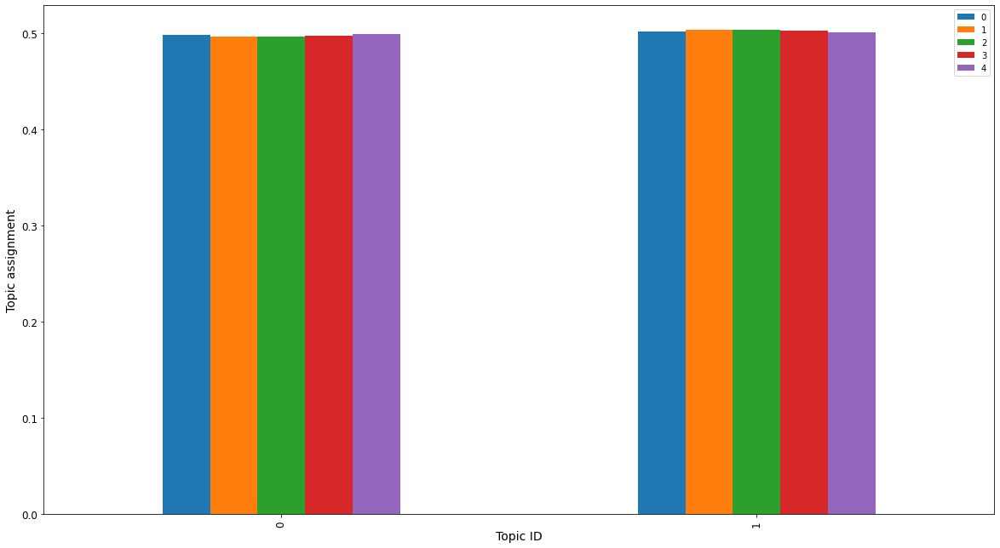

In [310]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

fs = 12
df=pd.DataFrame(predictions[:5].T)
df.plot(kind='bar', figsize=(20, 11), fontsize=fs)
plt.ylabel('Topic assignment', fontsize=fs+2)
plt.xlabel('Topic ID', fontsize=fs+2)

## Delete endpoint after performing inferences
---

In [329]:
sagemaker.Session().delete_endpoint(ntm_predictor.endpoint_name)

2021-07-02 05:06:56,432 | INFO | session.py:3023 | delete_endpoint | Deleting endpoint with name: ntm-2021-07-02-04-51-23-056


## Load model artifacts stored in output directory
---

In [324]:
model_path = os.path.join(output_prefix, ntm._current_job_name, "output/model.tar.gz")
model_path

'sagemaker/regalado/output/ntm-2021-07-02-04-47-09-212/output/model.tar.gz'

In [325]:
boto3.resource("s3").Bucket(bucket).download_file(model_path, "downloaded_model.tar.gz")

In [326]:
!pwd

/home/ec2-user/SageMaker/my-experiments


In [327]:
tarfile.open('downloaded_model.tar.gz').extractall()

with zipfile.ZipFile('model_algo-1', 'r') as zip_ref:
    zip_ref.extractall('./')
    
model = mx.ndarray.load("params")
W = model["arg:projection_weight"]

## Model exploration
---

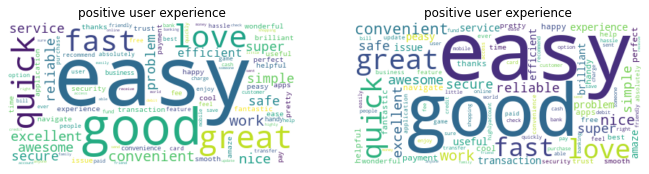

In [328]:
word_to_id = dict()

for i, v in enumerate(vocab_list):
    word_to_id[v] = i

limit = 30
n_col = 5
counter = 0

plt.figure(figsize=(30, 20))

for ind in range(num_topics):

    if counter >= limit:
        break
        
    title_str = topics[ind]
#     title_str = f'{ind}'
    pvals = mx.nd.softmax(mx.nd.array(W[:, ind])).asnumpy()
    word_freq = dict()
    
    for k in word_to_id.keys():
        i = word_to_id[k]
        word_freq[k] = pvals[i]

    wordcloud = wc.WordCloud(background_color="white").fit_words(word_freq)

    plt.subplot(limit // n_col, n_col, counter + 1)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(title_str)

    counter += 1